# Rainfall Weather Forecasting

## Project Description

Weather forecasting is the application of science and technology to predict the conditions of the atmosphere for a given location and time. Weather forecasts are made by collecting quantitative data about the current state of the atmosphere at a given place and using meteorology to project how the atmosphere will change.

Rain Dataset is to predict whether or not it will rain tomorrow. The Dataset contains about 10 years of daily weather observations of different locations in Australia. Here, predict two things:
 
### 1. Problem Statement: 

a) Design a predictive model with the use of machine learning algorithms to forecast whether or not it will rain tomorrow.

b)  Design a predictive model with the use of machine learning algorithms to predict how much rainfall could be there.


## Dataset Description:

Number of columns: 23


Date  - The date of observation

Location  -The common name of the location of the weather station

MinTemp  -The minimum temperature in degrees celsius

MaxTemp -The maximum temperature in degrees celsius

Rainfall  -The amount of rainfall recorded for the day in mm

Evaporation  -The so-called Class A pan evaporation (mm) in the 24 hours to 9am

Sunshine  -The number of hours of bright sunshine in the day.

WindGustDi r- The direction of the strongest wind gust in the 24 hours to midnight

WindGustSpeed -The speed (km/h) of the strongest wind gust in the 24 hours to midnight

WindDir9am -Direction of the wind at 9am

WindDir3pm -Direction of the wind at 3pm

WindSpeed9am -Wind speed (km/hr) averaged over 10 minutes prior to 9am

WindSpeed3pm -Wind speed (km/hr) averaged over 10 minutes prior to 3pm

Humidity9am -Humidity (percent) at 9am

Humidity3pm -Humidity (percent) at 3pm

Pressure9am -Atmospheric pressure (hpa) reduced to mean sea level at 9am

Pressure3pm -Atmospheric pressure (hpa) reduced to mean sea level at 3pm

Cloud9am - Fraction of sky obscured by cloud at 9am. 

Cloud3pm -Fraction of sky obscured by cloud at 3pm.

Temp9am-Temperature (degrees C) at 9am

Temp3pm -Temperature (degrees C) at 3pm

RainToday -Boolean: 1 if precipitation (mm) in the 24 hours to 9am exceeds 1mm, otherwise 0
    
RainTomorrow -The amount of next day rain in mm. Used to create response variable . A kind of measure of the "risk".


## Dataset Link-  

•	https://raw.githubusercontent.com/dsrscientist/dataset3/main/weatherAUS.csv
    
•	https://github.com/dsrscientist/dataset3


In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')

# Importing Data

In [3]:
df=pd.read_csv('weatherAUS.csv')

# EDA

In [4]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


In [5]:
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
8420,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
8421,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
8422,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
8423,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
8424,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


In [6]:
#Checking the dimentions of the dataset

df.shape

(8425, 23)

The dataset has 8,425 rows and 23 columns.

In [7]:
#Checking the columns of the dataset

df.columns.to_list()

['Date',
 'Location',
 'MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustDir',
 'WindGustSpeed',
 'WindDir9am',
 'WindDir3pm',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'RainToday',
 'RainTomorrow']

In [8]:
# Checking the types of columns

df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

The dataset has 2 different type of data float64 and object.

In [9]:
# Checking the null values

df.isnull().sum()

Date                0
Location            0
MinTemp            75
MaxTemp            60
Rainfall          240
Evaporation      3512
Sunshine         3994
WindGustDir       991
WindGustSpeed     991
WindDir9am        829
WindDir3pm        308
WindSpeed9am       76
WindSpeed3pm      107
Humidity9am        59
Humidity3pm       102
Pressure9am      1309
Pressure3pm      1312
Cloud9am         2421
Cloud3pm         2455
Temp9am            56
Temp3pm            96
RainToday         240
RainTomorrow      239
dtype: int64

The dataset has missing values.

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8425 entries, 0 to 8424
Data columns (total 23 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           8425 non-null   object 
 1   Location       8425 non-null   object 
 2   MinTemp        8350 non-null   float64
 3   MaxTemp        8365 non-null   float64
 4   Rainfall       8185 non-null   float64
 5   Evaporation    4913 non-null   float64
 6   Sunshine       4431 non-null   float64
 7   WindGustDir    7434 non-null   object 
 8   WindGustSpeed  7434 non-null   float64
 9   WindDir9am     7596 non-null   object 
 10  WindDir3pm     8117 non-null   object 
 11  WindSpeed9am   8349 non-null   float64
 12  WindSpeed3pm   8318 non-null   float64
 13  Humidity9am    8366 non-null   float64
 14  Humidity3pm    8323 non-null   float64
 15  Pressure9am    7116 non-null   float64
 16  Pressure3pm    7113 non-null   float64
 17  Cloud9am       6004 non-null   float64
 18  Cloud3pm

<Axes: >

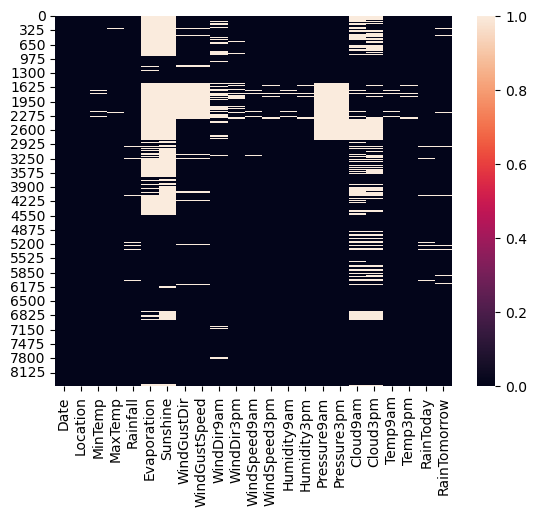

In [11]:
# Using heatmap to visualize the null values.

sns.heatmap(df.isnull())

In [12]:
# Checking for diblicate values

df.duplicated().sum()

1663

There are 1,663 dublicate values. We can drop them.

In [13]:
#Dropping Duplocate values

df.drop_duplicates(keep='last', inplace=True)

In [14]:
#Checking again for dublicate values

df.duplicated().sum()

0

Now there is no dublicate values.

In [17]:
#Checking the number of unique values in each column

df.nunique().to_frame("Number of unique values")

,Number of unique values
Date,3004
Location,12
MinTemp,285
MaxTemp,331
Rainfall,250
Evaporation,116
Sunshine,140
WindGustDir,16
WindGustSpeed,52
WindDir9am,16


## Separating categorical and numerical columns.

In [19]:
cat_columns = []

for i in df.dtypes.index:
    if df.dtypes[i]=="object":
        cat_columns.append(i)
print('Categorical Columns: ', cat_columns)
print('\n')


num_columns = []

for i in df.dtypes.index:
    if df.dtypes[i]!="object":
        num_columns.append(i)
print('Numerical Columns: ', num_columns)

Categorical Columns:  ['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm', 'RainToday', 'RainTomorrow']


Numerical Columns:  ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm']


In [20]:
# Using Simle Imputer to fill in the missing data in the categorical columns

from sklearn.impute import SimpleImputer

imp=SimpleImputer(strategy="most_frequent")

df['WindGustDir']=imp.fit_transform(df['WindGustDir'].values.reshape(-1,1))
df['WindDir9am']=imp.fit_transform(df['WindDir9am'].values.reshape(-1,1))
df['WindDir3pm']=imp.fit_transform(df['WindDir3pm'].values.reshape(-1,1))
df['RainToday']=imp.fit_transform(df['RainToday'].values.reshape(-1,1))
df['RainTomorrow']=imp.fit_transform(df['RainTomorrow'].values.reshape(-1,1))

In [21]:
# For filling in the missing data in the Numerical columns we gonna calculate the mean

df['MinTemp']=df['MinTemp'].fillna((df['MinTemp'].mean()))
df['MaxTemp']=df['MaxTemp'].fillna((df['MaxTemp'].mean()))
df['Rainfall']=df['Rainfall'].fillna((df['Rainfall'].mean()))
df['Evaporation']=df['Evaporation'].fillna((df['Evaporation'].mean()))
df['Sunshine']=df['Sunshine'].fillna((df['Sunshine'].mean()))
df['WindGustSpeed']=df['WindGustSpeed'].fillna((df['WindGustSpeed'].mean()))
df['WindSpeed9am']=df['WindSpeed9am'].fillna((df['WindSpeed9am'].mean()))
df['WindSpeed3pm']=df['WindSpeed3pm'].fillna((df['WindSpeed3pm'].mean()))
df['Humidity9am']=df['Humidity9am'].fillna((df['Humidity9am'].mean()))
df['Humidity3pm']=df['Humidity3pm'].fillna((df['Humidity3pm'].mean()))
df['Pressure9am']=df['Pressure9am'].fillna((df['Pressure9am'].mean()))
df['Pressure3pm']=df['Pressure3pm'].fillna((df['Pressure3pm'].mean()))
df['Cloud9am']=df['Cloud9am'].fillna((df['Cloud9am'].mean()))
df['Cloud3pm']=df['Cloud3pm'].fillna((df['Cloud3pm'].mean()))
df['Temp9am']=df['Temp9am'].fillna((df['Temp9am'].mean()))
df['Temp3pm']=df['Temp3pm'].fillna((df['Temp3pm'].mean()))

In [22]:
# Checking again for Null values

df.isnull().sum()

Date             0
Location         0
MinTemp          0
MaxTemp          0
Rainfall         0
Evaporation      0
Sunshine         0
WindGustDir      0
WindGustSpeed    0
WindDir9am       0
WindDir3pm       0
WindSpeed9am     0
WindSpeed3pm     0
Humidity9am      0
Humidity3pm      0
Pressure9am      0
Pressure3pm      0
Cloud9am         0
Cloud3pm         0
Temp9am          0
Temp3pm          0
RainToday        0
RainTomorrow     0
dtype: int64

Now we don't have missing data

## Description of the dataset

In [24]:
# for numerical data

df.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
count,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000,6762.000000
mean,13.109145,24.098345,2.780148,5.302395,7.890896,38.977663,12.782206,17.571150,67.506559,50.467147,1017.626311,1015.119923,4.336806,4.320988,17.895038,22.708561
std,5.540667,6.130123,10.482769,3.343713,2.733639,13.376457,9.787577,9.548634,17.182700,18.498341,6.027914,5.967638,2.474649,2.323276,5.722411,5.971845
min,-2.000000,8.200000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,10.000000,6.000000,989.800000,982.900000,0.000000,0.000000,1.900000,7.300000
25%,9.000000,19.600000,0.000000,4.000000,7.890896,30.000000,6.000000,11.000000,56.000000,38.000000,1014.200000,1011.500000,2.000000,3.000000,13.900000,18.400000
50%,13.109145,23.500000,0.000000,5.302395,7.890896,38.977663,11.000000,17.000000,68.000000,50.000000,1017.626311,1015.119923,4.336806,4.320988,17.900000,22.300000
75%,17.400000,28.400000,1.200000,5.302395,9.200000,46.000000,19.000000,24.000000,80.000000,62.000000,1020.900000,1018.400000,7.000000,6.000000,22.200000,26.800000
max,28.500000,45.500000,371.000000,145.000000,13.900000,107.000000,63.000000,83.000000,100.000000,99.000000,1039.000000,1036.000000,8.000000,8.000000,39.400000,44.100000


In [25]:
# for object data

df.describe(include="object")

,Date,Location,WindGustDir,WindDir9am,WindDir3pm,RainToday,RainTomorrow
count,6762,6762,6762,6762,6762,6762,6762
unique,3004,12,16,16,16,2,2
top,2011-02-11,PerthAirport,E,N,SE,No,No
freq,4,1204,1460,1403,971,5190,5190


- In 'Rainfall' the mean is slightly higher than the median, which means the data is slighly skewed to the right.
- In 'WindSpeed9am' the mean is slightly higher than the median, which means the data is slighly skewed to the right.
- In 'Location' there are 12 unique values, the top one is Perth Airport with frequency 1204.
- In 'WindGusDir' there are 16 unique values, the top one is E (East) with frequancy 1460.
- In 'WindDir9am' there are 16 unique values, the top one is N (North) with frequancy 1403.
- In 'WindDir3pm' there are 16 unique values, the top one is SE (South East) with frequancy 971.
- In 'RainToday' there are 2 unique values, the top one is No with frequancy 5190.
- In 'RainTomorrow' there are 2 unique values, the top one is No with frequancy 5190.

# Data Visualization

## Univariate Analysis

No     5190
Yes    1572
Name: RainTomorrow, dtype: int64


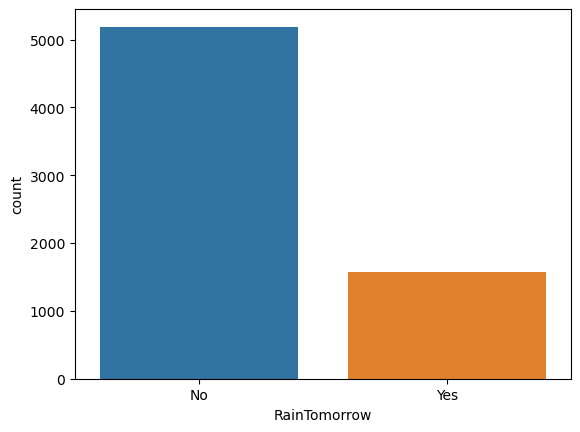

In [26]:
# Visualization of the target RainTomorrow

sns.countplot(x='RainTomorrow',data=df)
print(df['RainTomorrow'].value_counts())

'RainTomorrow' represents weather will be raining tomorrow or not, with two possible values 'Yes' or 'No'. The count of 'No' outcome is higher, which means is more likely not to rain.

0.000000      4334
0.200000       321
0.400000       144
2.780148       138
0.600000        87
              ... 
73.800000        1
23.800000        1
61.200000        1
128.000000       1
40.000000        1
Name: Rainfall, Length: 251, dtype: int64


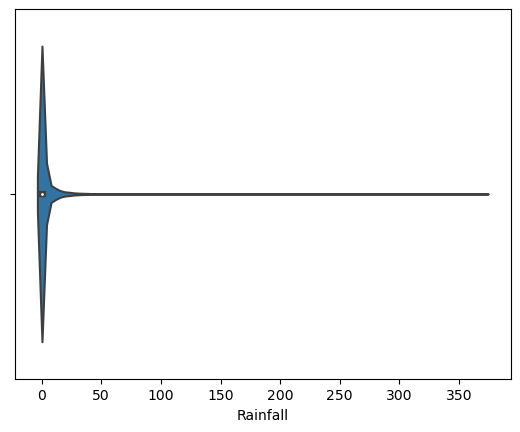

In [30]:
# Visualization of the target Rainfall

sns.violinplot(x='Rainfall',data=df)
print(df['Rainfall'].value_counts())

'Rainfall' column represents the amount of rainfall recorded for the day in mm. The most common rainfall amount in the dataset is 0.0 mm, which appears 4334 times, which means no rain was recorded on those days.

PerthAirport    1204
Albury           907
Newcastle        822
Melbourne        811
Williamtown      615
CoffsHarbour     611
Brisbane         579
Penrith          482
Darwin           250
Wollongong       237
Adelaide         205
Uluru             39
Name: Location, dtype: int64


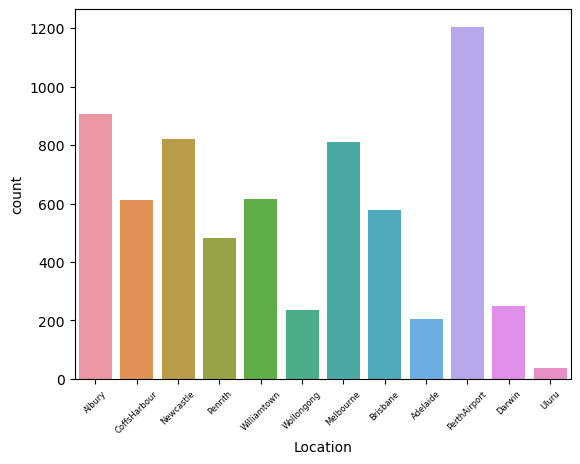

In [32]:
# Visualization of the Location

sns.countplot(x='Location',data=df)
plt.xticks(rotation=45, fontsize=6)
print(df['Location'].value_counts())

The most common location is Perth Airport which appears 1204 times. Other common places are Albury, Newcastle and Melbourne. The most uncommon place is Uluru.

E      1460
SW      465
N       459
W       434
WSW     420
WNW     398
SSE     390
S       376
SE      370
ENE     357
NE      300
SSW     299
NW      296
NNE     287
ESE     267
NNW     184
Name: WindGustDir, dtype: int64


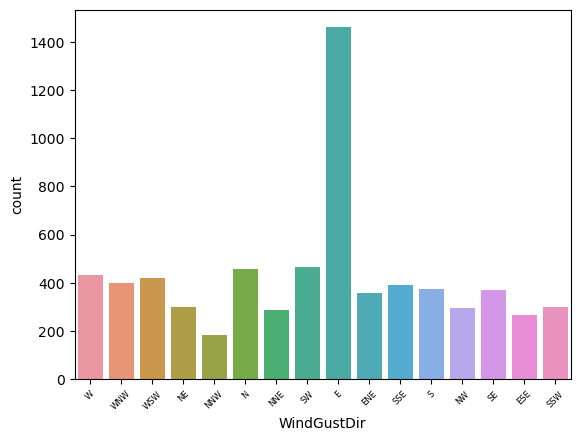

In [33]:
# Visualization of the WindGustDir

sns.countplot(x='WindGustDir',data=df)
plt.xticks(rotation=45, fontsize=6)
print(df['WindGustDir'].value_counts())

'WindGustDir' represents the direction of the strongest wind gust in the 24 hours to midnight. 'E' (East) is the most common direction, which appears 1460 times.

N      1403
SW      590
NW      463
SE      439
ENE     397
WSW     394
SSW     368
NE      364
E       338
NNE     337
S       324
WNW     301
SSE     300
W       299
ESE     229
NNW     216
Name: WindDir9am, dtype: int64


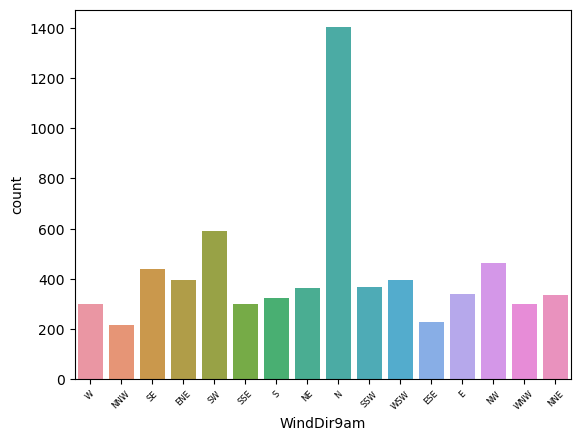

In [34]:
# Visualization of the WindDir9am

sns.countplot(x='WindDir9am',data=df)
plt.xticks(rotation=45, fontsize=6)
print(df['WindDir9am'].value_counts())

'WindDir9am' represents the direction of the wind at 9am. 'N' (North) is the most common one, which appears 1403 times.

SE     971
WSW    499
S      493
NE     480
SW     428
SSE    421
NW     400
W      399
E      392
WNW    389
ESE    363
N      354
ENE    348
NNE    305
SSW    277
NNW    243
Name: WindDir3pm, dtype: int64


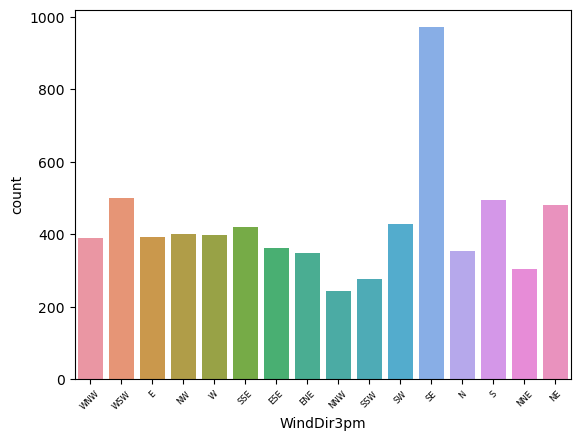

In [35]:
# Visualization of the WindDir3pm

sns.countplot(x='WindDir3pm',data=df)
plt.xticks(rotation=45, fontsize=6)
print(df['WindDir3pm'].value_counts())

'WindDir3pm' represents the direction of the wind at 3pm. The most common one is SE (South East), which appears 971 times.

No     5190
Yes    1572
Name: RainToday, dtype: int64


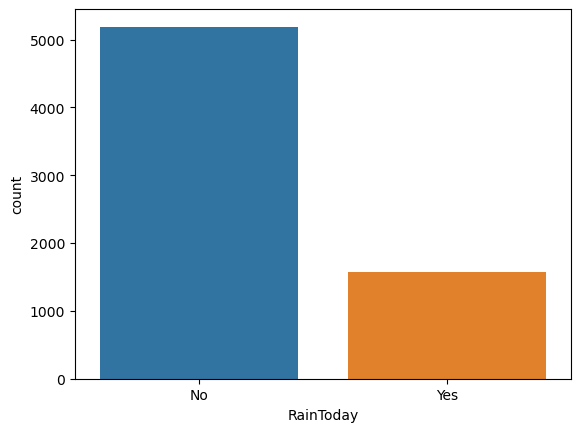

In [37]:
# Visualization of the RainToday

sns.countplot(x='RainToday',data=df)
print(df['RainToday'].value_counts())

In [39]:
# Converting Date datatypes and spliting date into date, month and year.
df['Date']=pd.to_datetime(df['Date'])
df['Day']=df['Date'].apply(lambda x:x.day)
df['Month']=df['Date'].apply(lambda x:x.month)
df['Year']=df['Date'].apply(lambda x:x.year)

# Dropping date column
df.drop('Date', axis=1, inplace = True)

#checking dataframe
df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.9,0.6,5.302395,7.890896,W,44.0,W,WNW,...,1007.1,8.000000,4.320988,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.1,0.0,5.302395,7.890896,WNW,44.0,NNW,WSW,...,1007.8,4.336806,4.320988,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.7,0.0,5.302395,7.890896,WSW,46.0,W,WSW,...,1008.7,4.336806,2.000000,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.0,0.0,5.302395,7.890896,NE,24.0,SE,E,...,1012.8,4.336806,4.320988,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.3,1.0,5.302395,7.890896,W,41.0,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12,2008


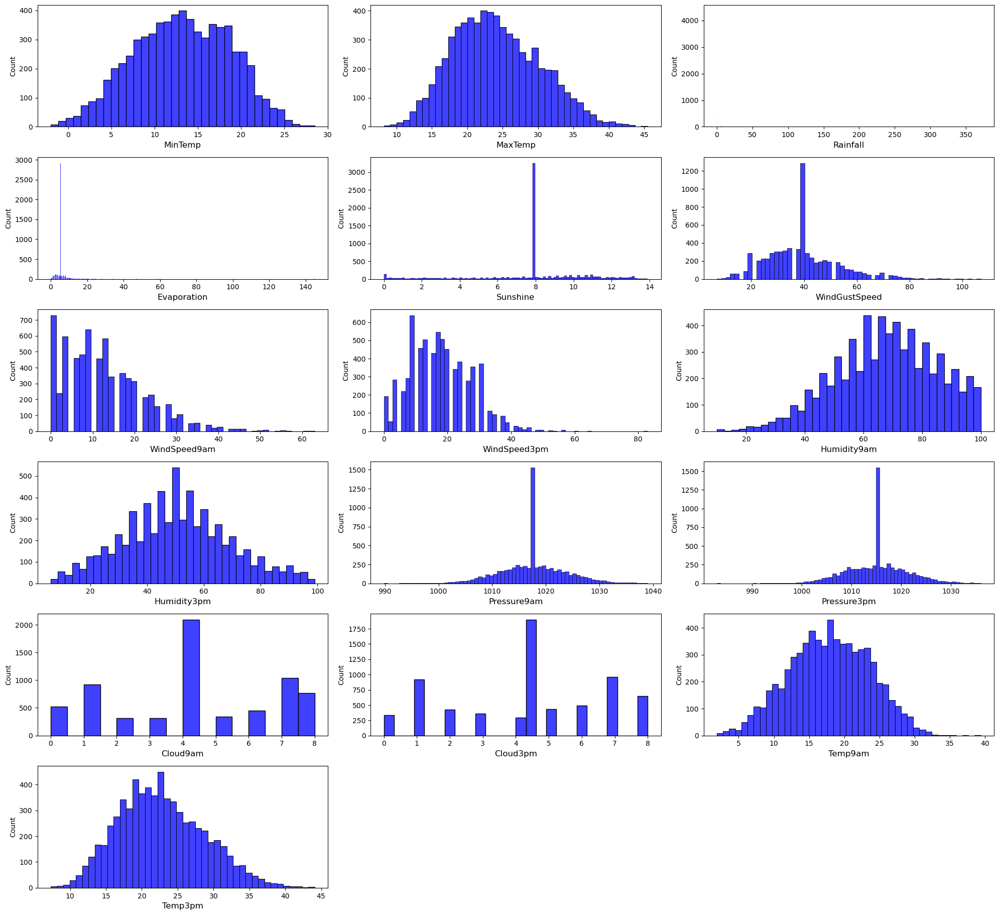

In [40]:
#Visiualizing the numerical columns

plt.figure(figsize=(20,30), facecolor='white')
plotnumber=1
for col in num_columns:
    if plotnumber<=30:
        ax=plt.subplot(10,3,plotnumber) 
        sns.histplot(x=df[col], data=df, color='b')
        plt.xlabel(col,fontsize=12)
    plotnumber+=1
    
plt.tight_layout()
plt.show()

- 'MinTemp' represents the minimum temperature in degrees celsius, the most common min temperature is in a range of 10-19 degrees celsium.
- 'MaxTemp' represents the maximum temperature in degrees celsius, the most common max temperature is in a range of 18-126 degrees celsium.
- 'Sunshine' represents the number of hours of bright sunshine in the day. The most common is 7 hours a day.
- 'WindGustSpeed' represents the speed (km/h) of the strongest wind gust in the 24 hours to midnight, the most common one is 38 km/h.
- 'WindSpeed9am' represents the Wind speed (km/hr) averaged over 10 minutes prior to 9am. The speed varies but most common ones are 0, 8, 14 km/hr.
- 'WindSpeed3pm' represents the Wind speed (km/hr) averaged over 10 minutes prior to 3pm. The speed varies but most common ones are 8, 14, 16, 18 km/h.
- 'Humidity9am' - Humidity (percent) at 9am. Most common ones are in the range of 68-74 %.
- 'Humidity3pm' - Humidity (percent) at 3pm. Most common ones are in the range of 46-52 %.
- 'Pressure9am' -Atmospheric pressure (hpa) reduced to mean sea level at 9am. Most common ones are in the range od 1014-1020.
- 'Pressure3pm' -Atmospheric pressure (hpa) reduced to mean sea level at 3pm. Most common ones are in the range od 1016-1018.
- 'Cloud9am' - Fraction of sky obscured by cloud at 9am. Most common one is 4.
- 'Cloud3pm' -Fraction of sky obscured by cloud at 3pm. Most common one is 4.5
- 'Temp9am'- Temperature (degrees C) at 9am. Most common one is in a range of 15-24 degrees.
- 'Temp3pm' -Temperature (degrees C) at 3pm. Most common is in a range of 18-23 degress.

10    224
23    224
20    224
25    224
24    224
21    224
22    224
7     223
8     223
9     223
11    223
12    223
18    222
13    222
19    222
6     222
28    221
1     221
16    221
17    221
2     221
15    221
14    221
5     221
4     221
3     221
26    220
27    220
29    206
30    202
31    133
Name: Day, dtype: int64


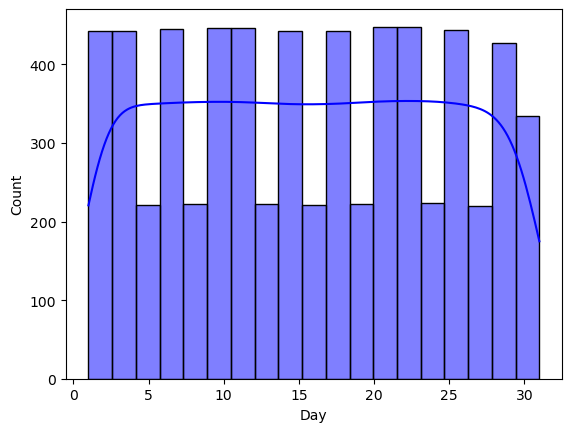

In [48]:
# Visualization the Day

sns.histplot(df['Day'],kde=True,color='b')
print(df['Day'].value_counts())

There is no specific relationship for the days.

6     673
5     646
7     614
3     606
8     589
1     569
12    555
10    529
9     519
11    503
4     480
2     479
Name: Month, dtype: int64


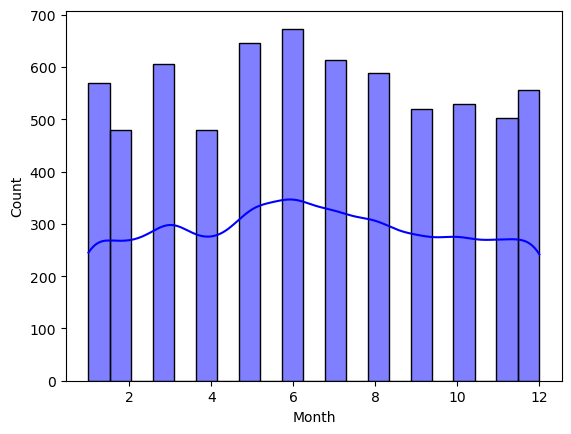

In [49]:
# Visualization the Month

sns.histplot(df['Month'],kde=True,color='b')
print(df['Month'].value_counts())

It looks that in the months like June, May and July was raining more. April and February less records of rain. 

2011    1133
2010    1078
2014     959
2009     950
2012     876
2015     580
2013     543
2016     366
2017     215
2008      62
Name: Year, dtype: int64


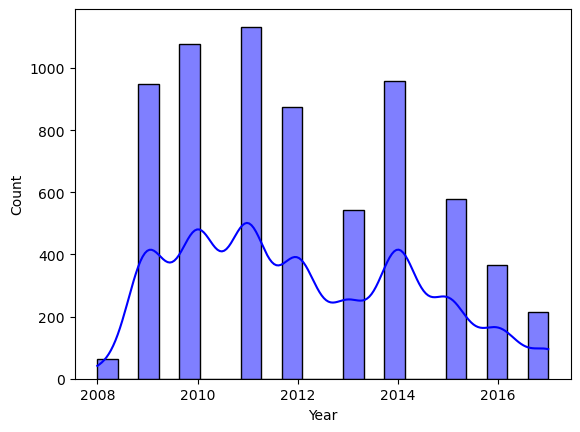

In [50]:
# Visualization the Year

sns.histplot(df['Year'],kde=True,color='b')
print(df['Year'].value_counts())

In the years 2010 and 2011 rain was recorded more compared with the rest of the years.

## Bivariate Analysis

### RainTomorrow as target

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11]),
 [Text(0, 0, 'Albury'),
  Text(1, 0, 'CoffsHarbour'),
  Text(2, 0, 'Newcastle'),
  Text(3, 0, 'Penrith'),
  Text(4, 0, 'Williamtown'),
  Text(5, 0, 'Wollongong'),
  Text(6, 0, 'Melbourne'),
  Text(7, 0, 'Brisbane'),
  Text(8, 0, 'Adelaide'),
  Text(9, 0, 'PerthAirport'),
  Text(10, 0, 'Darwin'),
  Text(11, 0, 'Uluru')])

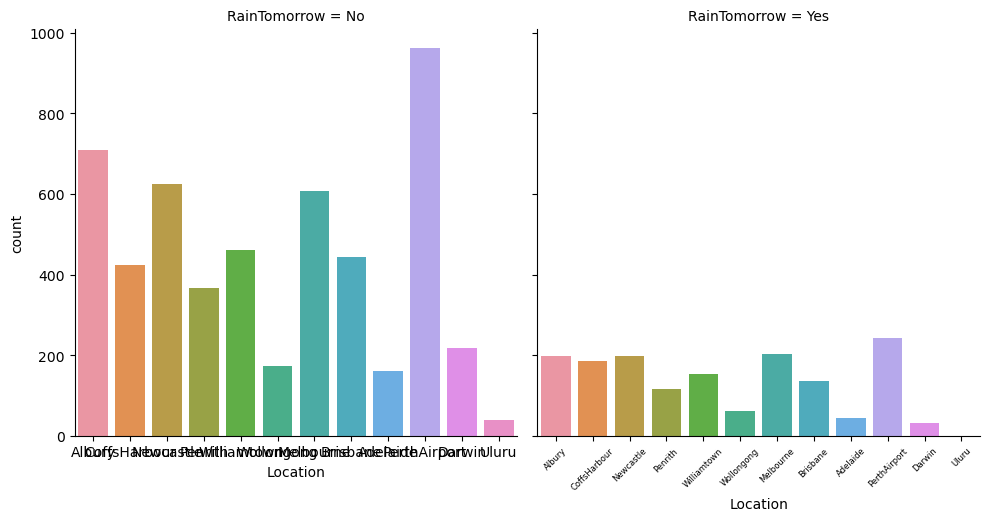

In [57]:
# Comparing RainTomorrow vs Location

sns.catplot(x='Location',col='RainTomorrow',data=df,kind='count')
plt.xticks(rotation=45, fontsize=6)

For No RainTomorrow we have high percentages of not raining in places like Perth Airport, Albury, Newcastle and Melbourne.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'W'),
  Text(1, 0, 'WNW'),
  Text(2, 0, 'WSW'),
  Text(3, 0, 'NE'),
  Text(4, 0, 'NNW'),
  Text(5, 0, 'N'),
  Text(6, 0, 'NNE'),
  Text(7, 0, 'SW'),
  Text(8, 0, 'E'),
  Text(9, 0, 'ENE'),
  Text(10, 0, 'SSE'),
  Text(11, 0, 'S'),
  Text(12, 0, 'NW'),
  Text(13, 0, 'SE'),
  Text(14, 0, 'ESE'),
  Text(15, 0, 'SSW')])

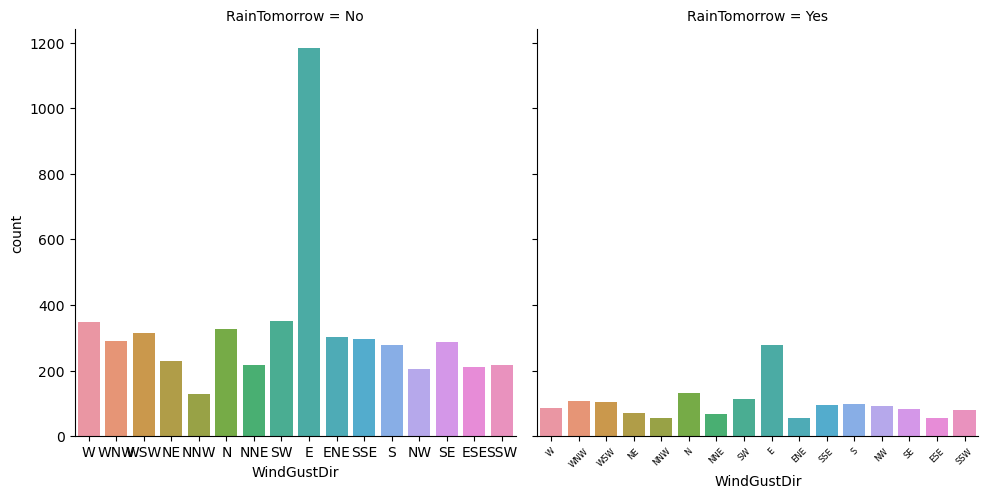

In [58]:
# Comparing RainTomorrow vs WindGustDir

sns.catplot(x='WindGustDir',col='RainTomorrow',data=df,kind='count')
plt.xticks(rotation=45, fontsize=6)

For 'No' in 'RainTomorrow' (No rain forecast) 'E', 'W', 'NW', 'SW', and 'SE' are the dominant wind gust directions.
For 'Yes' in 'RainTomorrow' (Rain forecast) 'E', 'W' and 'NW' are still dominant.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'W'),
  Text(1, 0, 'NNW'),
  Text(2, 0, 'SE'),
  Text(3, 0, 'ENE'),
  Text(4, 0, 'SW'),
  Text(5, 0, 'SSE'),
  Text(6, 0, 'S'),
  Text(7, 0, 'NE'),
  Text(8, 0, 'N'),
  Text(9, 0, 'SSW'),
  Text(10, 0, 'WSW'),
  Text(11, 0, 'ESE'),
  Text(12, 0, 'E'),
  Text(13, 0, 'NW'),
  Text(14, 0, 'WNW'),
  Text(15, 0, 'NNE')])

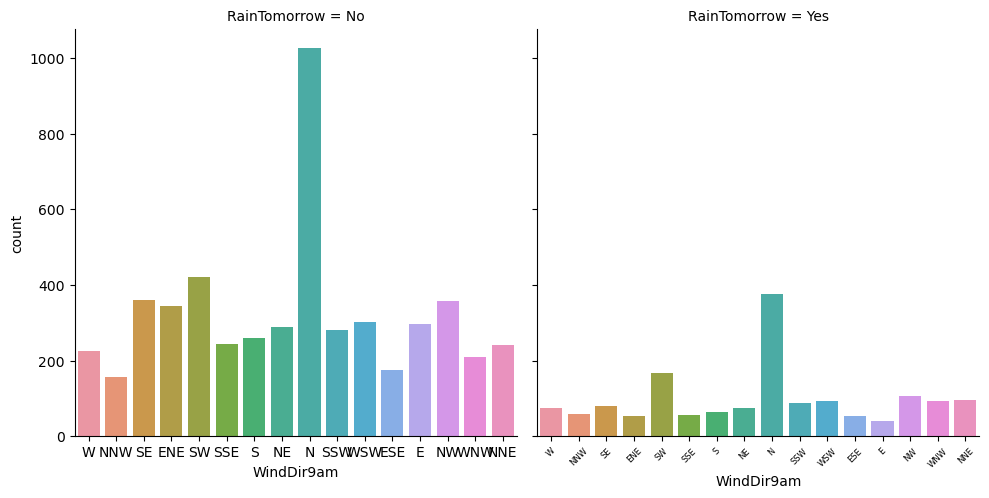

In [59]:
# Comparing RainTomorrow vs WindDir9am

sns.catplot(x='WindDir9am',col='RainTomorrow',data=df,kind='count')
plt.xticks(rotation=45, fontsize=6)

For 'No' in 'RainTomorrow' (No rain forecast) 'N', 'ENE' 'NW', 'SW', and 'SE' are the dominant wind speed at 9am.
For 'Yes' in 'RainTomorrow' (Rain forecast) 'N', 'SW' and 'NW' are still dominant.

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15]),
 [Text(0, 0, 'WNW'),
  Text(1, 0, 'WSW'),
  Text(2, 0, 'E'),
  Text(3, 0, 'NW'),
  Text(4, 0, 'W'),
  Text(5, 0, 'SSE'),
  Text(6, 0, 'ESE'),
  Text(7, 0, 'ENE'),
  Text(8, 0, 'NNW'),
  Text(9, 0, 'SSW'),
  Text(10, 0, 'SW'),
  Text(11, 0, 'SE'),
  Text(12, 0, 'N'),
  Text(13, 0, 'S'),
  Text(14, 0, 'NNE'),
  Text(15, 0, 'NE')])

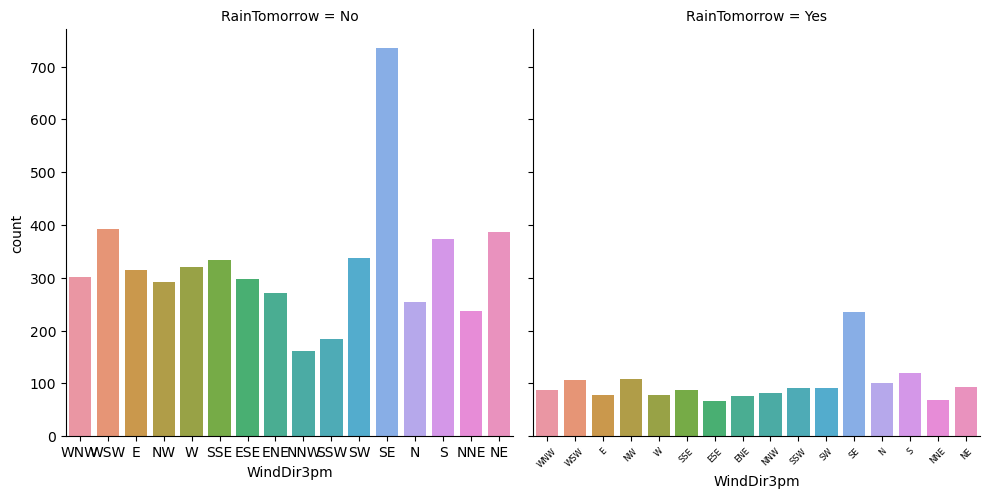

In [60]:
# Comparing RainTomorrow vs WindDir3pm

sns.catplot(x='WindDir3pm',col='RainTomorrow',data=df,kind='count')
plt.xticks(rotation=45, fontsize=6)

For 'No' in 'RainTomorrow' (No rain forecast) 'SE', 'WSW', 'NE' and 'S' are the dominant wind speed at 3pm.
For 'Yes' in 'RainTomorrow' (Rain forecast) 'SE' and 'S' are still dominant.

(array([0, 1]), [Text(0, 0, 'No'), Text(1, 0, 'Yes')])

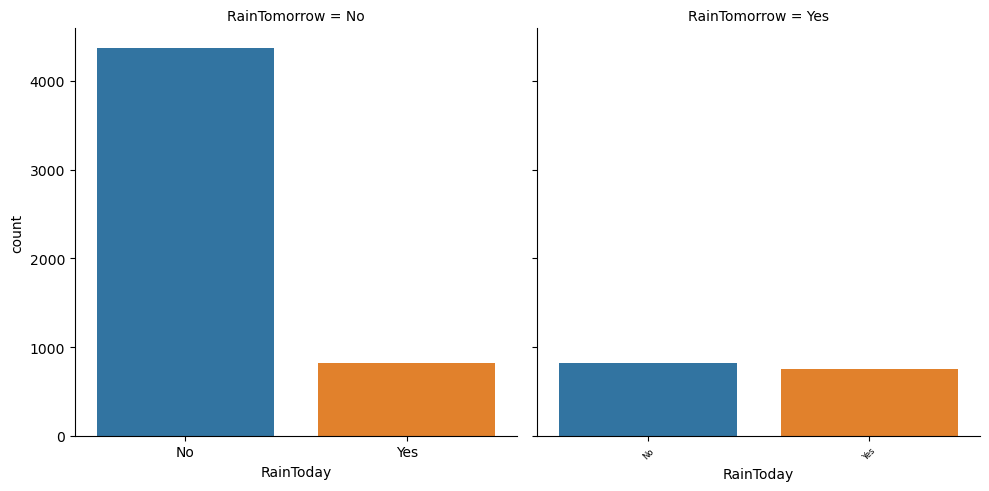

In [61]:
# Comparing RainTomorrow vs RainToday

sns.catplot(x='RainToday',col='RainTomorrow',data=df,kind='count')
plt.xticks(rotation=45, fontsize=6)

When 'RainToday' is 'No', there is a high possibility of 'No' forecasts for 'RainTomorrow'.
When 'RainToday' is 'Yes', the possibility of 'Yes' forecasts for 'RainTomorrow' is also high

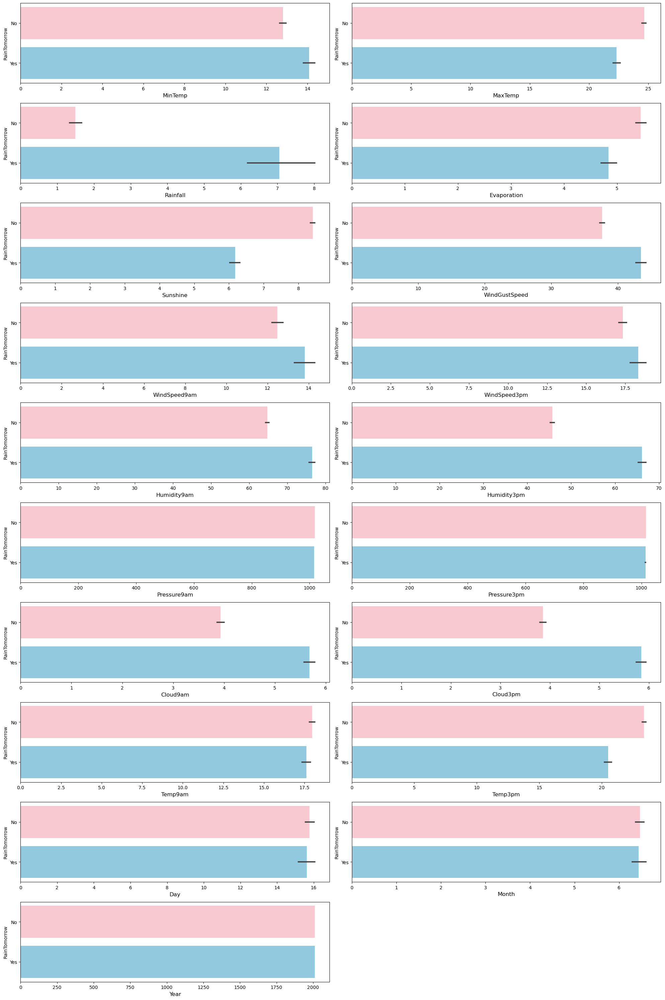

In [70]:
#Visiualizing the numerical columns vs Rain_tomorrow

plt.figure(figsize=(20,30), facecolor='white')
plotnumber=1

for col in num_columns:
    if plotnumber<=20:
        ax=plt.subplot(10,2,plotnumber) 
        sns.barplot(x=df[col],y=df['RainTomorrow'], palette={"Yes": 'skyblue', "No": 'pink'})
        plt.xlabel(col,fontsize=12)
    plotnumber+=1
    
plt.tight_layout()
plt.show()

- If the MaxTemp is higher no rain tomorrow.
- If there are more hours Sunshine the possibility for No rain forecast is higher.
- Higher Evaporation the possibility for No rain forecast is higher.
- higher wind speed the possibility for Yes rain is higher.
- Higher humidity, higher possibility for Yes rain.
- There are no connection between the Air pressure and the possibility for rain.
- More Clouds, higher possibility for Yes rain.
- Higher temperatures, higher possibility for No rain.
- There is no connection between day,month and year and possibility for rain.


### Rainfall as Target

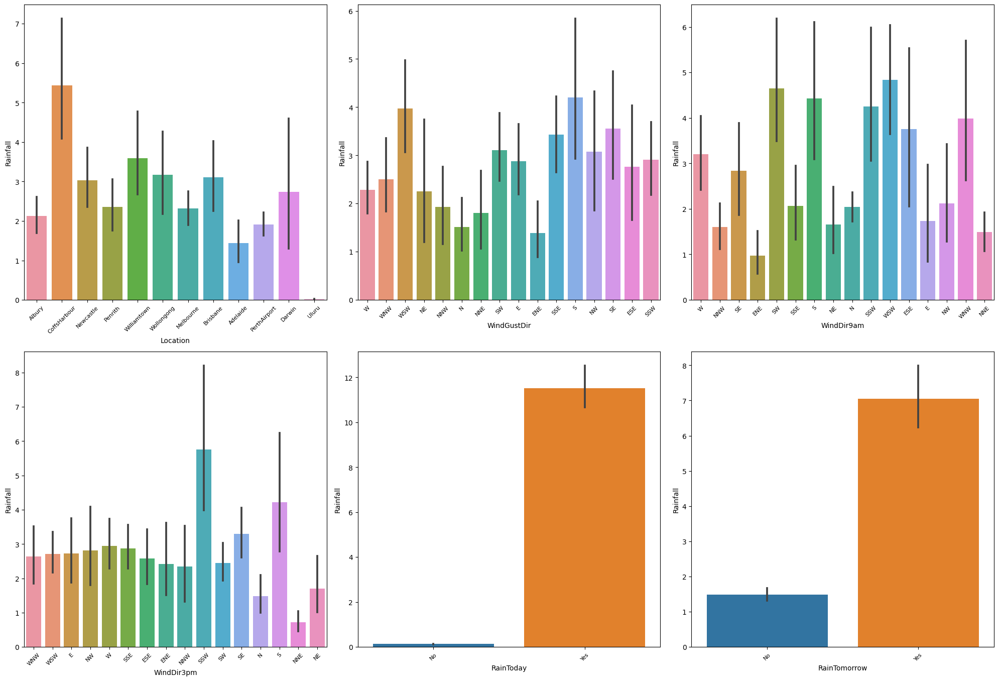

In [72]:
# Visualization of Categorical columns Vs Rainfall

plt.figure(figsize=(20, 20), facecolor='white')
p = 1

for i in cat_columns:
    if p <= 9:
        plt.subplot(3, 3, p)
        ax = sns.barplot(x=i, y='Rainfall', data=df)
        plt.xticks(rotation=45,fontsize=8)
    p += 1

plt.tight_layout()
plt.show()

- Locations like CoffsHarbour, Willimtown, Wollongong and Brisbane have higher count of rain,
- For direction of the wind S, WSW, SE, SSE, the Rainfall is higher.
- For direction of the wind 9am WSW, SW, S the Rainfall is higher.
- For direction of the wind 3pm SWS, S, SE the Rainfall is higher.
- For Yes rain today the Rainfall is significantly higher.
- For Yes rain Tomorrow the Rainfall is higher.

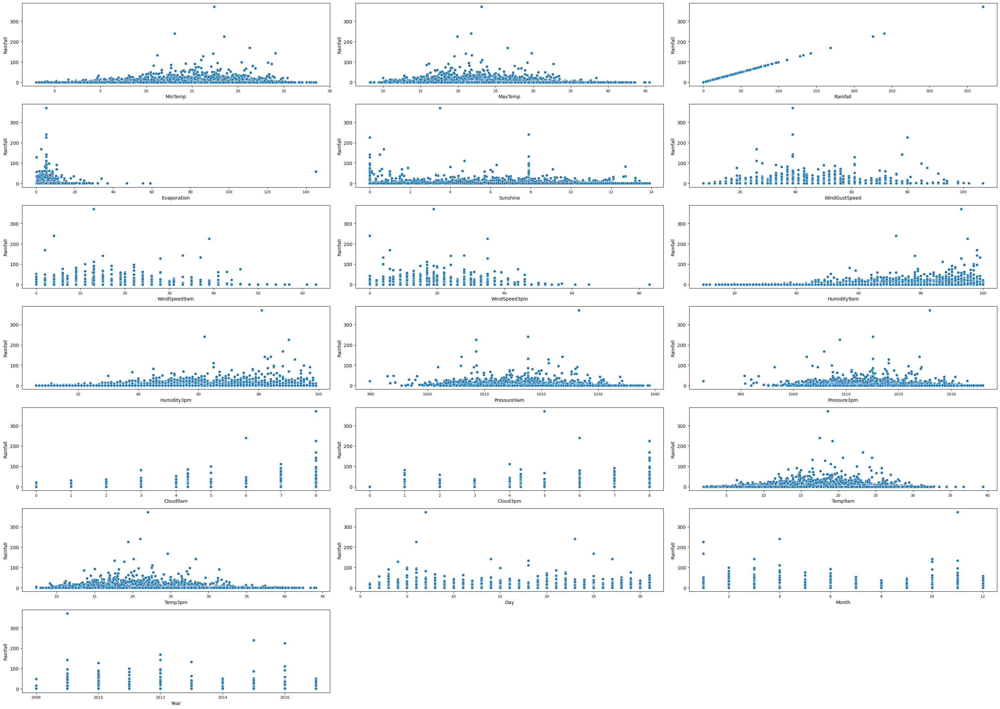

In [75]:
# Visualization of Numerical columns Vs Rainfall

plt.figure(figsize=(30,30), facecolor='white')
p = 1

for j in num_columns:
    if p <= 30:
        plt.subplot(10, 3, p)
        ax = sns.scatterplot(x=j, y='Rainfall', data=df)
        plt.xticks(fontsize=8)
    p += 1

plt.tight_layout()
plt.show()

## Multivariate Analysis

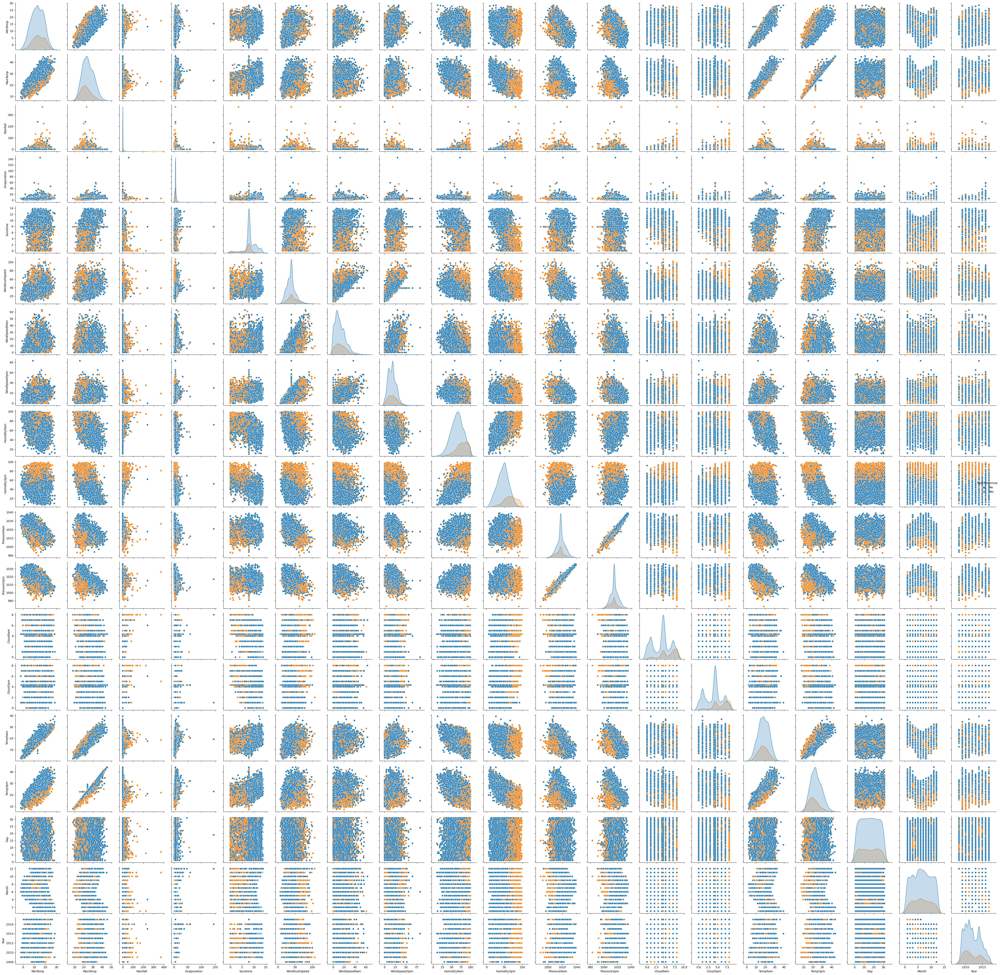

In [76]:
# RainTomorrow as Target

sns.pairplot(df)
plt.tight_layout()

## Checking for outliers

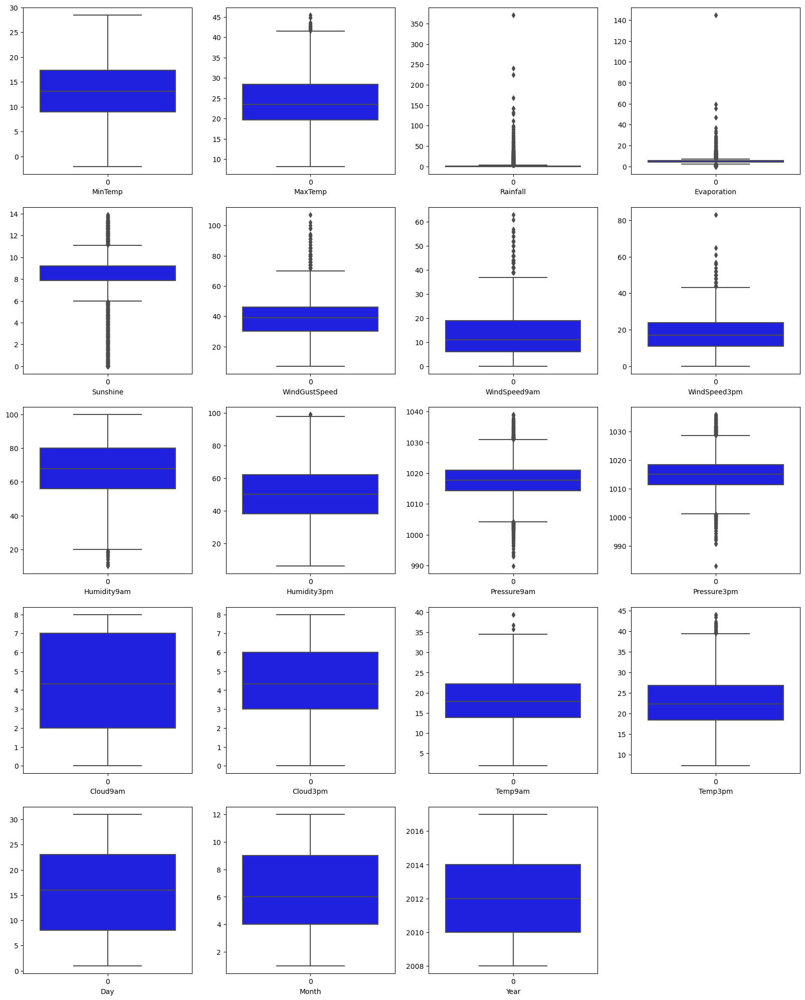

In [78]:
# Checking for outliers only for numerical columns

plt.figure(figsize=(20,25))
pnum=1
for i in num_columns:
    if pnum<=20:
        plt.subplot(5,4,pnum)
        sns.boxplot(df[i],color='b')
        plt.xlabel(i)
    pnum+=1
plt.show()

## Removing the outliers

In [79]:
from scipy.stats import zscore

outliers=df[num_columns]

z=np.abs(zscore(outliers))
z

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,Day,Month,Year
0,0.052498,1.954990e-01,0.207990,2.656460e-16,3.249310e-16,3.754887e-01,0.737499,0.673324,0.203327,1.539016,1.646846,1.344002,1.480398,0.000000,0.173897,0.152152,1.675969,1.639768,1.761148
1,1.030484,1.634110e-01,0.265231,2.656460e-16,3.249310e-16,3.754887e-01,0.897347,0.463855,1.368138,1.376828,1.165715,1.226694,0.000000,0.000000,0.121468,0.266510,1.562245,1.639768,1.761148
2,0.037750,2.612956e-01,0.265231,2.656460e-16,3.249310e-16,5.250161e-01,0.635321,0.882794,1.717352,1.106513,1.663437,1.075869,0.000000,0.999089,0.542637,0.082299,1.448521,1.639768,1.761148
3,0.705589,6.365197e-01,0.265231,2.656460e-16,3.249310e-16,1.119786e+00,0.182102,0.897697,1.309935,1.863394,0.004365,0.388779,0.000000,0.000000,0.035820,0.634933,1.334798,1.639768,1.761148
4,0.792536,1.338026e+00,0.169829,2.656460e-16,3.249310e-16,1.511975e-01,0.590814,0.254385,0.843553,0.944325,1.132534,1.528343,1.076270,1.583662,0.016609,1.170820,1.221074,1.639768,1.761148
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8420,1.860770,1.139286e-01,0.265231,2.656460e-16,3.249310e-16,5.964399e-01,0.022254,0.688228,0.960721,1.430891,1.156985,0.868092,0.000000,0.000000,1.362295,0.051673,0.598504,0.136841,2.150387
8421,1.716373,1.960392e-01,0.265231,2.656460e-16,3.249310e-16,1.269314e+00,0.022254,0.897697,0.669709,1.593079,0.974487,0.666993,0.000000,0.000000,1.222484,0.300003,0.712227,0.136841,2.150387
8422,1.391478,4.570647e-01,0.265231,2.656460e-16,3.249310e-16,1.478575e-01,0.386458,0.897697,0.844316,1.430891,0.559719,0.281552,0.000000,0.000000,0.942861,0.567947,0.825951,0.136841,2.150387
8423,0.958285,4.733788e-01,0.265231,2.656460e-16,3.249310e-16,8.207311e-01,0.022254,1.107167,0.960721,1.430891,0.294268,0.231277,0.540240,0.999089,0.488473,0.551200,0.939675,0.136841,2.150387


In [80]:
threshold=3
print(np.where(z>3))

(array([   8,   12,   12,   44,   44,   52,   52,   60,   60,   61,   61,
         62,   62,   62,   67,   68,   68,  123,  267,  271,  296,  381,
        381,  405,  406,  407,  431,  462,  466,  466,  563,  567,  568,
        568,  569,  602,  602,  603,  683,  683,  699,  713,  748,  748,
        770,  795,  796,  797,  802,  928,  928,  935,  949,  979,  980,
        980,  980, 1008, 1009, 1011, 1138, 1148, 1149, 1151, 1189, 1203,
       1237, 1241, 1264, 1265, 1357, 1411, 1412, 1413, 1479, 1480, 1481,
       1513, 1535, 1587, 1644, 1661, 1665, 1673, 1680, 1774, 1819, 1873,
       1898, 1903, 1945, 2016, 2028, 2043, 2074, 2108, 2116, 2186, 2201,
       2219, 2219, 2230, 2231, 2265, 2429, 2488, 2500, 2505, 2527, 2527,
       2541, 2593, 2676, 2677, 2735, 2827, 2835, 2849, 2849, 2855, 2859,
       2863, 2869, 2877, 2883, 2890, 2891, 2897, 2898, 2900, 2900, 2901,
       2905, 2909, 2911, 2919, 2925, 2933, 2939, 2947, 2953, 2961, 2967,
       2975, 2989, 3003, 3027, 3045, 3051, 3051, 3

In [85]:
df_new=df[(z<3).all(axis=1)]  
df_new.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,Albury,13.4,22.9,0.6,5.302395,7.890896,W,44.0,W,WNW,...,1007.1,8.000000,4.320988,16.9,21.8,No,No,1,12,2008
1,Albury,7.4,25.1,0.0,5.302395,7.890896,WNW,44.0,NNW,WSW,...,1007.8,4.336806,4.320988,17.2,24.3,No,No,2,12,2008
2,Albury,12.9,25.7,0.0,5.302395,7.890896,WSW,46.0,W,WSW,...,1008.7,4.336806,2.000000,21.0,23.2,No,No,3,12,2008
3,Albury,9.2,28.0,0.0,5.302395,7.890896,NE,24.0,SE,E,...,1012.8,4.336806,4.320988,18.1,26.5,No,No,4,12,2008
4,Albury,17.5,32.3,1.0,5.302395,7.890896,W,41.0,ENE,NW,...,1006.0,7.000000,8.000000,17.8,29.7,No,No,5,12,2008


In [84]:
df.shape

(6762, 25)

In [86]:
df_new.shape

(6409, 25)

353 rows have been removed as outliers.

In [87]:
# Checking the data loss percentage after removing the outliers

print("Data Loss Percentage:", ((df.shape[0]-df_new.shape[0])/df.shape[0])*100)  

Data Loss Percentage: 5.220349009168885


## Checking for skewness

In [88]:
df=df_new

In [89]:
df.skew()

MinTemp         -0.079107
MaxTemp          0.265797
Rainfall         3.515410
Evaporation      0.721400
Sunshine        -0.890629
WindGustSpeed    0.477235
WindSpeed9am     0.677433
WindSpeed3pm     0.341549
Humidity9am     -0.233044
Humidity3pm      0.158509
Pressure9am      0.064023
Pressure3pm      0.090093
Cloud9am        -0.203578
Cloud3pm        -0.147217
Temp9am         -0.072513
Temp3pm          0.290192
Day              0.004771
Month            0.032770
Year             0.352924
dtype: float64

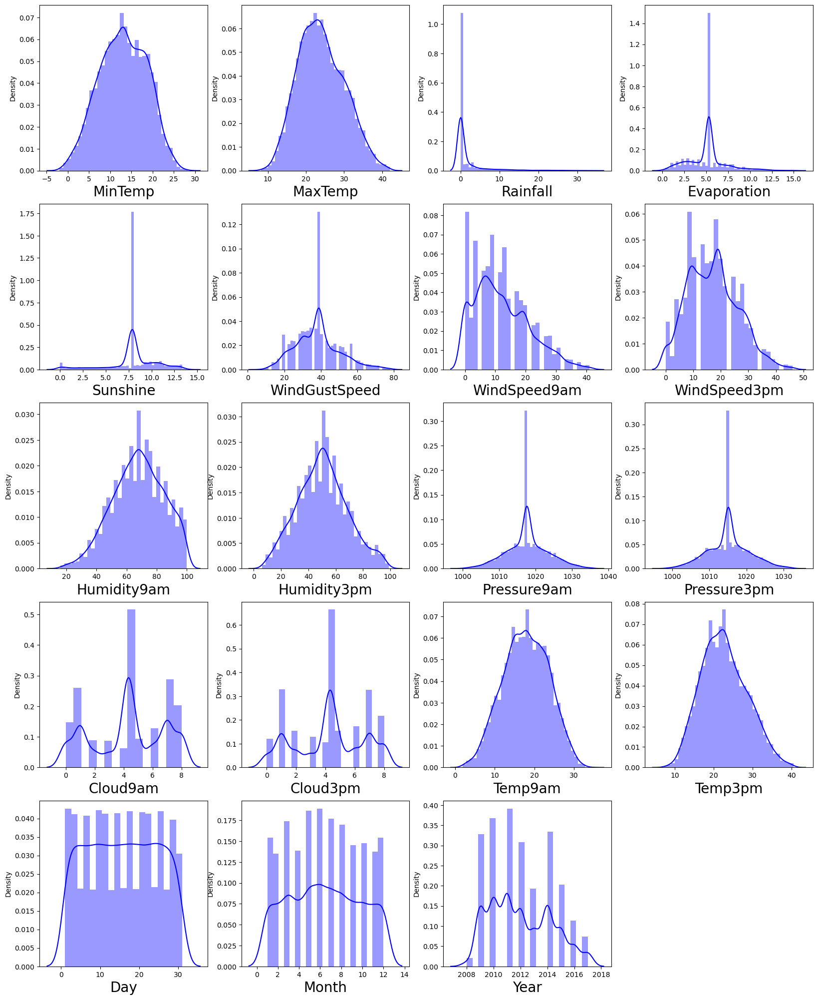

<Figure size 640x480 with 0 Axes>

In [90]:
plt.figure(figsize=(20,25), facecolor='white')

plotnumber=1

for i in num_columns:   
    if plotnumber<=20:
        plt.subplot(5,4,plotnumber)
        sns.distplot(df[i],color='b')
        plt.xlabel(i,fontsize=20)
    plotnumber+=1
plt.show()
plt.tight_layout()

- In Rainfall the data is skewed to the right.
- In Evaporation the data is slightly skewed to the right.
- In WindSpeed9am the data is also slightly skewed to the right.

## Removing of skewness

In [91]:
df['Rainfall'] = df['Rainfall'].apply(lambda x: np.cbrt(x))
df['Evaporation'] = df['Evaporation'].apply(lambda x: np.cbrt(x))
df['WindSpeed9am'] = df['WindSpeed9am'].apply(lambda x: np.cbrt(x))

In [92]:
df.skew()

MinTemp         -0.079107
MaxTemp          0.265797
Rainfall         1.390231
Evaporation     -0.983357
Sunshine        -0.890629
WindGustSpeed    0.477235
WindSpeed9am    -1.172540
WindSpeed3pm     0.341549
Humidity9am     -0.233044
Humidity3pm      0.158509
Pressure9am      0.064023
Pressure3pm      0.090093
Cloud9am        -0.203578
Cloud3pm        -0.147217
Temp9am         -0.072513
Temp3pm          0.290192
Day              0.004771
Month            0.032770
Year             0.352924
dtype: float64

The skewness has been reduced.

## Encoding categorical data

In [93]:
# Encoding the categorical data into numerical using Label Encoder

from sklearn.preprocessing import LabelEncoder

le = LabelEncoder()

df['Location']=le.fit_transform(df['Location'])
df['WindGustDir']=le.fit_transform(df['WindGustDir'])
df['WindDir9am']=le.fit_transform(df['WindDir9am'])
df['WindDir3pm']=le.fit_transform(df['WindDir3pm'])
df['RainToday']=le.fit_transform(df['RainToday'])
df['RainTomorrow']=le.fit_transform(df['RainTomorrow'])

In [94]:
df.head()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
0,1,13.4,22.9,0.843433,1.743776,7.890896,13,44.0,13,14,...,1007.1,8.000000,4.320988,16.9,21.8,0,0,1,12,2008
1,1,7.4,25.1,0.000000,1.743776,7.890896,14,44.0,6,15,...,1007.8,4.336806,4.320988,17.2,24.3,0,0,2,12,2008
2,1,12.9,25.7,0.000000,1.743776,7.890896,15,46.0,13,15,...,1008.7,4.336806,2.000000,21.0,23.2,0,0,3,12,2008
3,1,9.2,28.0,0.000000,1.743776,7.890896,4,24.0,9,0,...,1012.8,4.336806,4.320988,18.1,26.5,0,0,4,12,2008
4,1,17.5,32.3,1.000000,1.743776,7.890896,13,41.0,1,7,...,1006.0,7.000000,8.000000,17.8,29.7,0,0,5,12,2008


In [95]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6409 entries, 0 to 8424
Data columns (total 25 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Location       6409 non-null   int32  
 1   MinTemp        6409 non-null   float64
 2   MaxTemp        6409 non-null   float64
 3   Rainfall       6409 non-null   float64
 4   Evaporation    6409 non-null   float64
 5   Sunshine       6409 non-null   float64
 6   WindGustDir    6409 non-null   int32  
 7   WindGustSpeed  6409 non-null   float64
 8   WindDir9am     6409 non-null   int32  
 9   WindDir3pm     6409 non-null   int32  
 10  WindSpeed9am   6409 non-null   float64
 11  WindSpeed3pm   6409 non-null   float64
 12  Humidity9am    6409 non-null   float64
 13  Humidity3pm    6409 non-null   float64
 14  Pressure9am    6409 non-null   float64
 15  Pressure3pm    6409 non-null   float64
 16  Cloud9am       6409 non-null   float64
 17  Cloud3pm       6409 non-null   float64
 18  Temp9am 

In [96]:
df.describe()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
count,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,...,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000,6409.000000
mean,5.289905,13.016775,24.049650,0.517601,1.680260,7.938772,6.597441,38.081886,7.012326,7.848026,...,1015.244238,4.300534,4.280158,17.825175,22.677998,0.222968,0.223124,15.699485,6.450460,2012.044469
std,3.083406,5.540592,6.025237,0.812226,0.276415,2.690796,5.237574,12.246086,4.546542,4.478796,...,5.668201,2.473809,2.320043,5.687165,5.868318,0.416269,0.416373,8.790753,3.352858,2.284546
min,0.000000,-2.000000,8.200000,0.000000,0.000000,0.000000,0.000000,7.000000,0.000000,0.000000,...,997.600000,0.000000,0.000000,1.900000,7.300000,0.000000,0.000000,1.000000,1.000000,2008.000000
25%,2.000000,8.900000,19.600000,0.000000,1.587401,7.890896,1.000000,30.000000,3.000000,4.000000,...,1011.800000,2.000000,2.000000,13.800000,18.400000,0.000000,0.000000,8.000000,4.000000,2010.000000
50%,6.000000,13.109145,23.600000,0.000000,1.743776,7.890896,7.000000,38.977663,7.000000,9.000000,...,1015.119923,4.336806,4.320988,17.895038,22.300000,0.000000,0.000000,16.000000,6.000000,2012.000000
75%,8.000000,17.300000,28.300000,1.000000,1.743776,9.200000,12.000000,44.000000,11.000000,12.000000,...,1018.400000,7.000000,6.000000,22.100000,26.700000,0.000000,0.000000,23.000000,9.000000,2014.000000
max,11.000000,28.300000,42.000000,3.245952,2.477125,13.900000,15.000000,78.000000,15.000000,15.000000,...,1033.000000,8.000000,8.000000,34.500000,40.500000,1.000000,1.000000,31.000000,12.000000,2017.000000


## Checking the correlation between the target variable and the independent variables.

In [97]:
cor=df.corr()
cor

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow,Day,Month,Year
Location,1.000000,0.091439,0.073529,0.014779,0.103045,0.059077,-0.087036,0.275369,-0.102857,-0.000346,...,-0.018320,-0.006174,-0.005406,0.098705,0.069773,-0.004653,0.000418,-0.004955,-0.070870,0.504670
MinTemp,0.091439,1.000000,0.730203,0.090406,0.338640,0.045007,-0.141975,0.243945,-0.021262,-0.143715,...,-0.447642,0.095244,0.045078,0.892887,0.699067,0.072751,0.093202,0.018823,-0.235576,0.033619
MaxTemp,0.073529,0.730203,1.000000,-0.229311,0.450160,0.358251,-0.203423,0.170578,-0.193433,-0.165553,...,-0.426387,-0.240845,-0.239589,0.865352,0.974864,-0.219715,-0.158541,0.020013,-0.173102,0.084633
Rainfall,0.014779,0.090406,-0.229311,1.000000,-0.190540,-0.274007,0.109686,0.092169,0.153846,0.108366,...,-0.046494,0.318732,0.271814,-0.090531,-0.241211,0.876483,0.336398,-0.012314,0.007338,0.017993
Evaporation,0.103045,0.338640,0.450160,-0.190540,1.000000,0.401073,-0.138828,0.175180,-0.117027,-0.025499,...,-0.291504,-0.102176,-0.149546,0.399158,0.440033,-0.181301,-0.104680,0.006123,-0.044118,0.130533
Sunshine,0.059077,0.045007,0.358251,-0.274007,0.401073,1.000000,-0.096169,0.039776,-0.079345,-0.053672,...,-0.084864,-0.535310,-0.558181,0.242516,0.376674,-0.238391,-0.334757,-0.002603,0.001859,0.055028
WindGustDir,-0.087036,-0.141975,-0.203423,0.109686,-0.138828,-0.096169,1.000000,-0.005278,0.382238,0.455730,...,-0.007103,0.113797,0.074331,-0.158044,-0.214280,0.108601,0.034610,0.016953,0.033051,-0.184693
WindGustSpeed,0.275369,0.243945,0.170578,0.092169,0.175180,0.039776,-0.005278,1.000000,-0.070025,0.090029,...,-0.327380,-0.001037,0.036077,0.224148,0.138991,0.077282,0.163628,-0.003702,0.049319,-0.014431
WindDir9am,-0.102857,-0.021262,-0.193433,0.153846,-0.117027,-0.079345,0.382238,-0.070025,1.000000,0.207631,...,0.058118,0.070864,0.054555,-0.067048,-0.202146,0.149524,0.034901,-0.007416,0.022424,-0.083633
WindDir3pm,-0.000346,-0.143715,-0.165553,0.108366,-0.025499,-0.053672,0.455730,0.090029,0.207631,1.000000,...,-0.040758,0.070165,0.049111,-0.150565,-0.176777,0.095603,-0.000224,0.001373,0.029937,0.005251


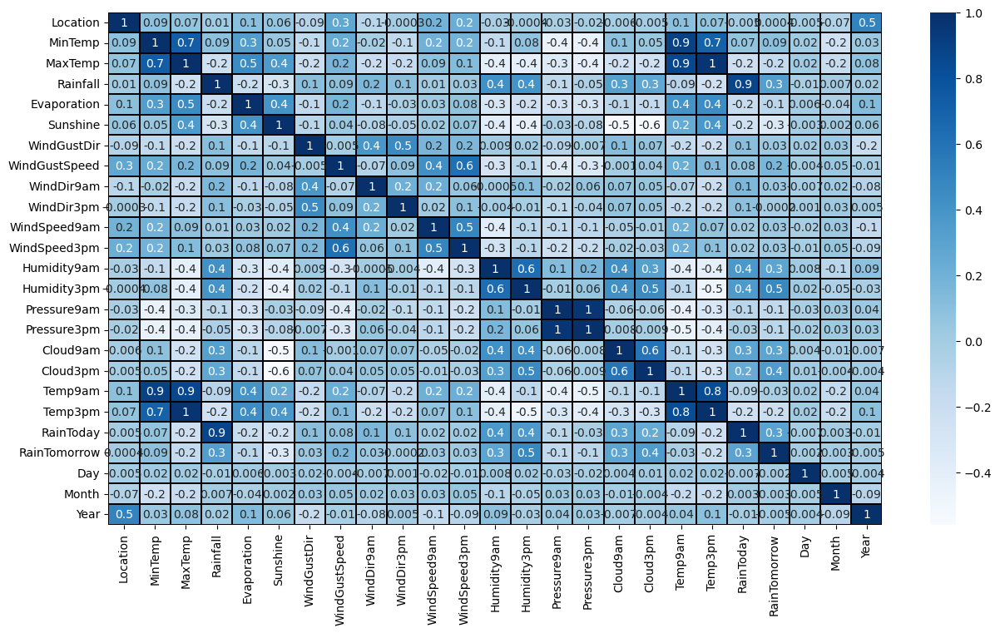

In [98]:
# Vusualizing the correlation

plt.figure(figsize=(15,8))
sns.heatmap(df.corr(), linewidths=0.1,fmt='.1g',linecolor='black', annot = True, cmap = 'Blues')
plt.yticks(rotation=0);
plt.show()

## Correlation with RainTomorrow as a target variable

In [99]:
#Correlation when we have RainTomorrow as a target

cor_a=cor['RainTomorrow'].sort_values(ascending=False)
cor_a

RainTomorrow     1.000000
Humidity3pm      0.464801
Cloud3pm         0.351601
Rainfall         0.336398
RainToday        0.303565
Cloud9am         0.287603
Humidity9am      0.284159
WindGustSpeed    0.163628
MinTemp          0.093202
WindDir9am       0.034901
WindGustDir      0.034610
WindSpeed9am     0.033409
WindSpeed3pm     0.025175
Location         0.000418
WindDir3pm      -0.000224
Day             -0.001717
Month           -0.003259
Year            -0.004690
Temp9am         -0.026504
Evaporation     -0.104680
Pressure3pm     -0.112841
Pressure9am     -0.139575
MaxTemp         -0.158541
Temp3pm         -0.201905
Sunshine        -0.334757
Name: RainTomorrow, dtype: float64

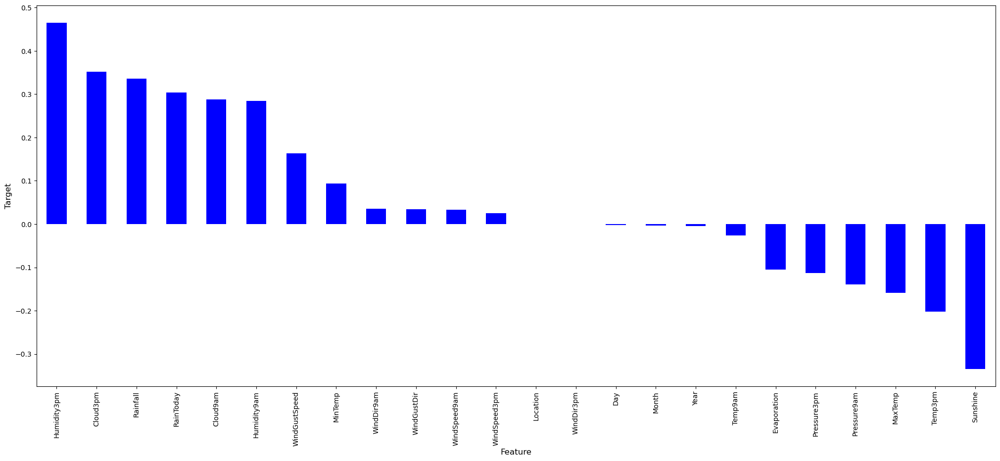

In [100]:
plt.figure(figsize=(25,10))

df.corr()['RainTomorrow'].sort_values(ascending=False).drop(['RainTomorrow']).plot(kind='bar',color='b')
plt.xlabel('Feature', fontsize=12)
plt.ylabel('Target', fontsize=12)
plt.show()

- There are some possitive correlation between the RainTomorrow and Humidity3pm, Cloud3pm, Rainfall, RainToday, Cloud9am, Humidity9am. Which suggests with the increase of these features it`s more likely to rain tomorrow.
- There some negative correlation between the target RainTomorrow and Sunshine. Which suggests the higher the amount of the sun hours is the possibility for rain is lower.

## Correlation with Rainfall as a target variable

In [105]:
#Correlation when we have Rainfall as a target

cor_b=cor['Rainfall'].sort_values(ascending=False)
cor_b

Rainfall         1.000000
RainToday        0.876483
Humidity9am      0.417093
Humidity3pm      0.397450
RainTomorrow     0.336398
Cloud9am         0.318732
Cloud3pm         0.271814
WindDir9am       0.153846
WindGustDir      0.109686
WindDir3pm       0.108366
WindGustSpeed    0.092169
MinTemp          0.090406
WindSpeed3pm     0.027015
Year             0.017993
Location         0.014779
WindSpeed9am     0.014292
Month            0.007338
Day             -0.012314
Pressure3pm     -0.046494
Temp9am         -0.090531
Pressure9am     -0.126124
Evaporation     -0.190540
MaxTemp         -0.229311
Temp3pm         -0.241211
Sunshine        -0.274007
Name: Rainfall, dtype: float64

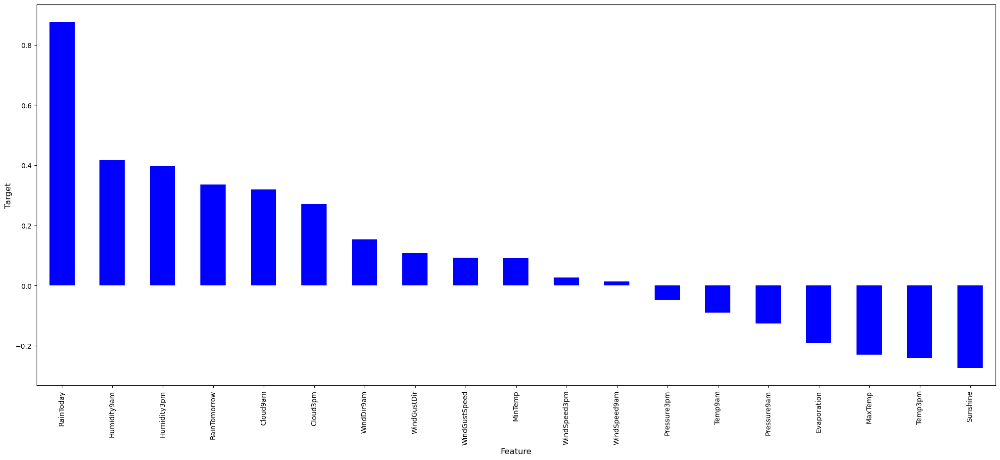

In [106]:
plt.figure(figsize=(25,10))

df.corr()['Rainfall'].sort_values(ascending=False).drop(['Rainfall']).plot(kind='bar',color='b')
plt.xlabel('Feature', fontsize=12)
plt.ylabel('Target', fontsize=12)
plt.show()

- There are some possitive correlation between the target Rainfall and RainToday, Humidity9am, Humidity3pm, RainTomorrow, Cloud9am, Cloud3pm. Which suggests with the increase of these features the Rainfall is higher.
- There some negative correlation between the target Rainfall and Sunshine, Temp3pm, MaxTemp. Which suggests the higher the amount of the sun hours and the tempretaure is the amount of rain is lower.

We can see that 'WindDir3pm','Location','Day','Year', 'Month' have very low correlation with the targets RainTomorrow and Rainfall, so we can drop them.

In [102]:
# dropping irrelevant columns

df.drop(columns=['WindDir3pm','Location','Day','Year', 'Month'],axis=1,inplace=True)

In [104]:
df.shape

(6409, 20)

# Classification Task - RainTomorrow as target

## Separating features and label

In [107]:
x=df.drop(['RainTomorrow'],axis=1)
y=df['RainTomorrow']

## Feature Scaling using Standard Scalarization

In [108]:
from sklearn.preprocessing import StandardScaler

scaler=StandardScaler()

x=pd.DataFrame(scaler.fit_transform(x), columns=x.columns)
x

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
0,0.069172,-0.190821,0.401190,0.229802,-0.017794,1.222524,0.483303,1.317076,0.789780,0.756780,0.199610,-1.559588,-1.759834,-1.436942,1.495570,0.017600,-0.162690,-0.149628,-0.535675
1,-1.013829,0.174339,-0.637312,0.229802,-0.017794,1.413467,0.483303,-0.222676,-0.515249,0.536178,-1.395627,-1.394797,-1.252796,-1.313436,0.014663,0.017600,-0.109936,0.276421,-0.535675
2,-0.021078,0.273928,-0.637312,0.229802,-0.017794,1.604410,0.646634,1.317076,0.736496,0.977382,-1.750124,-1.120144,-1.777318,-1.154643,0.014663,-0.982885,0.558287,0.088960,-0.535675
3,-0.688929,0.655685,-0.637312,0.229802,-0.017794,-0.495963,-1.149999,0.437218,0.221878,-0.897735,-1.336544,-1.889171,-0.028909,-0.431253,0.014663,0.017600,0.048327,0.651345,-0.535675
4,0.809223,1.369406,0.593968,0.229802,-0.017794,1.222524,0.238308,-1.322499,-0.138302,0.315576,0.849521,-0.955352,-1.217827,-1.631022,1.091303,1.603475,-0.004427,1.196689,-0.535675
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6404,-1.844130,-0.107830,-0.637312,0.229802,-0.017794,-1.259735,-0.578343,0.437218,0.369348,-0.677133,-0.982047,-1.449727,1.194978,0.892021,0.014663,0.017600,-1.358458,-0.047376,-0.535675
6405,-1.699730,0.207535,-0.637312,0.229802,-0.017794,-0.114077,-1.313329,0.437218,0.369348,-0.897735,-0.686633,-1.614519,1.002652,0.680297,0.014663,0.017600,-1.217780,0.310505,-0.535675
6406,-1.374830,0.473105,-0.637312,0.229802,-0.017794,-0.686906,-0.088352,0.437218,0.055253,-0.897735,-0.863881,-1.449727,0.565550,0.274493,0.014663,0.017600,-0.936423,0.583177,-0.535675
6407,-0.941629,0.489704,-0.637312,0.229802,-0.017794,0.458752,-0.823338,0.657182,0.369348,-1.118337,-0.982047,-1.449727,0.285805,0.221562,-0.525762,-0.982885,-0.479217,0.566135,-0.535675


## Checking Variance Inflation Factor VIF

In [111]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x.values, i) for i in range(len(x.columns))]
vif['Features']=x.columns

vif

,VIF values,Features
0,8.776903,MinTemp
1,26.172664,MaxTemp
2,4.719546,Rainfall
3,1.550303,Evaporation
4,2.023688,Sunshine
5,1.352286,WindGustDir
6,2.045817,WindGustSpeed
7,1.362307,WindDir9am
8,1.738333,WindSpeed9am
9,1.927543,WindSpeed3pm


By checking the VIF values we can find the features causing multicollineraty problem.

The VIF in Temp3pm, MaxTemp, Pressure9am, Pressure3pm and Temp9am. That means that there is multicollineraty between these features and the other features.

We will drop one of the columns to see if the same issue still exist.

In [112]:
x=x.drop('Temp3pm',axis=1)

In [113]:
# Checking again VIF

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x.values, i) for i in range(len(x.columns))]
vif['Features']=x.columns

vif

,VIF values,Features
0,8.701367,MinTemp
1,9.592733,MaxTemp
2,4.719442,Rainfall
3,1.549159,Evaporation
4,2.023561,Sunshine
5,1.346901,WindGustDir
6,2.038090,WindGustSpeed
7,1.360801,WindDir9am
8,1.738327,WindSpeed9am
9,1.923697,WindSpeed3pm


We still have multicolinearity problem, so we gonna drop one more column.

In [114]:
x=x.drop('Pressure9am',axis=1)

In [115]:
# Checking again VIF

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x.values, i) for i in range(len(x.columns))]
vif['Features']=x.columns

vif

,VIF values,Features
0,8.613695,MinTemp
1,9.225437,MaxTemp
2,4.689825,Rainfall
3,1.531099,Evaporation
4,2.017201,Sunshine
5,1.293836,WindGustDir
6,2.009927,WindGustSpeed
7,1.330771,WindDir9am
8,1.721398,WindSpeed9am
9,1.910448,WindSpeed3pm


We still have multicolinearity problem, so we gonna drop one more column.

In [116]:
x=x.drop('Temp9am',axis=1)

In [117]:
# Checking again VIF

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x.values, i) for i in range(len(x.columns))]
vif['Features']=x.columns

vif

,VIF values,Features
0,4.635668,MinTemp
1,5.497704,MaxTemp
2,4.689783,Rainfall
3,1.520558,Evaporation
4,1.994162,Sunshine
5,1.293593,WindGustDir
6,1.969386,WindGustSpeed
7,1.329665,WindDir9am
8,1.713730,WindSpeed9am
9,1.866421,WindSpeed3pm


Now we have solved multicolinearity issue.

## Oversampling

In [118]:
y.value_counts()

0    4979
1    1430
Name: RainTomorrow, dtype: int64

The target variable (RainTomorrow) has imbalanced data.

In [119]:
from imblearn.over_sampling import SMOTE
SM=SMOTE()
x,y=SM.fit_resample(x,y)

In [120]:
y.value_counts()

0    4979
1    4979
Name: RainTomorrow, dtype: int64

# Machine Learning for Classification Task (RainTomorrow as Target)

In [121]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

In [122]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=i)
    RFR=RandomForestClassifier()
    RFR.fit(x_train,y_train)
    pred=RFR.predict(x_test)
    acc=accuracy_score(y_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Best accuracy is",maxAccu,"at random_state",maxRS)

Best accuracy is 0.9082998661311914 at random_state 100


In [123]:
x.head()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday
0,0.069172,-0.190821,0.401190,0.229802,-0.017794,1.222524,0.483303,1.317076,0.789780,0.756780,0.199610,-1.559588,-1.436942,1.495570,0.017600,-0.535675
1,-1.013829,0.174339,-0.637312,0.229802,-0.017794,1.413467,0.483303,-0.222676,-0.515249,0.536178,-1.395627,-1.394797,-1.313436,0.014663,0.017600,-0.535675
2,-0.021078,0.273928,-0.637312,0.229802,-0.017794,1.604410,0.646634,1.317076,0.736496,0.977382,-1.750124,-1.120144,-1.154643,0.014663,-0.982885,-0.535675
3,-0.688929,0.655685,-0.637312,0.229802,-0.017794,-0.495963,-1.149999,0.437218,0.221878,-0.897735,-1.336544,-1.889171,-0.431253,0.014663,0.017600,-0.535675
4,0.809223,1.369406,0.593968,0.229802,-0.017794,1.222524,0.238308,-1.322499,-0.138302,0.315576,0.849521,-0.955352,-1.631022,1.091303,1.603475,-0.535675


In [124]:
y.head()

0    0
1    0
2    0
3    0
4    0
Name: RainTomorrow, dtype: int32

In [125]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.3, random_state=maxRS)

In [126]:
x_train.shape

(6970, 16)

In [127]:
y_train.shape

(6970,)

In [128]:
x_test.shape

(2988, 16)

In [129]:
y_test.shape

(2988,)

## Random Forest Classifier

In [130]:
rfc=RandomForestClassifier(n_estimators=200, random_state=maxRS)

In [131]:
rfc.fit(x_train, y_train)

RandomForestClassifier(n_estimators=200, random_state=100)

In [132]:
rfcpred= rfc.predict(x_test)

In [133]:
print(confusion_matrix(y_test, rfcpred))

[[1344  151]
 [ 122 1371]]


In [134]:
print(classification_report(y_test,rfcpred))

              precision    recall  f1-score   support

           0       0.92      0.90      0.91      1495
           1       0.90      0.92      0.91      1493

    accuracy                           0.91      2988
   macro avg       0.91      0.91      0.91      2988
weighted avg       0.91      0.91      0.91      2988



In [135]:
print('Accuracy Score of RFC: ', accuracy_score(y_test, rfcpred))

Accuracy Score of RFC:  0.9086345381526104


## GaussianNB

In [136]:
gnb=GaussianNB()

In [137]:
gnb.fit(x_train,y_train)

GaussianNB()

In [138]:
gnbpred= rfc.predict(x_test)

In [139]:
print(confusion_matrix(y_test, gnbpred))

[[1344  151]
 [ 122 1371]]


In [140]:
print(classification_report(y_test,gnbpred))

              precision    recall  f1-score   support

           0       0.92      0.90      0.91      1495
           1       0.90      0.92      0.91      1493

    accuracy                           0.91      2988
   macro avg       0.91      0.91      0.91      2988
weighted avg       0.91      0.91      0.91      2988



In [141]:
print('Accuracy Score of GaussianNB: ', accuracy_score(y_test, gnbpred))

Accuracy Score of GaussianNB:  0.9086345381526104


## K-Neighbors Classifier

In [142]:
knc=KNeighborsClassifier(n_neighbors=13)

In [143]:
knc.fit(x_train,y_train)

KNeighborsClassifier(n_neighbors=13)

In [145]:
kncpred=knc.predict(x_test)

In [146]:
print(confusion_matrix(y_test, kncpred))

[[1106  389]
 [ 128 1365]]


In [147]:
print(classification_report(y_test,kncpred))

              precision    recall  f1-score   support

           0       0.90      0.74      0.81      1495
           1       0.78      0.91      0.84      1493

    accuracy                           0.83      2988
   macro avg       0.84      0.83      0.83      2988
weighted avg       0.84      0.83      0.83      2988



In [148]:
print('Accuracy Score of K-Neighbors: ', accuracy_score(y_test, kncpred))

Accuracy Score of K-Neighbors:  0.8269745649263721


## Logistic regression

In [149]:
LR=LogisticRegression()

In [150]:
LR.fit(x_train,y_train)

LogisticRegression()

In [151]:
LRpred=LR.predict(x_test)

In [152]:
print(confusion_matrix(y_test, LRpred))

[[1214  281]
 [ 354 1139]]


In [153]:
print(classification_report(y_test,LRpred))

              precision    recall  f1-score   support

           0       0.77      0.81      0.79      1495
           1       0.80      0.76      0.78      1493

    accuracy                           0.79      2988
   macro avg       0.79      0.79      0.79      2988
weighted avg       0.79      0.79      0.79      2988



In [154]:
print('Accuracy Score of Logistic Regression: ', accuracy_score(y_test, LRpred))

Accuracy Score of Logistic Regression:  0.7874832663989291


## Decision Tree

In [155]:
dtc=DecisionTreeClassifier()

In [156]:
dtc.fit(x_train,y_train)

DecisionTreeClassifier()

In [157]:
dtcpred=dtc.predict(x_test)

In [158]:
print(confusion_matrix(y_test, dtcpred))

[[1198  297]
 [ 263 1230]]


In [159]:
print(classification_report(y_test,dtcpred))

              precision    recall  f1-score   support

           0       0.82      0.80      0.81      1495
           1       0.81      0.82      0.81      1493

    accuracy                           0.81      2988
   macro avg       0.81      0.81      0.81      2988
weighted avg       0.81      0.81      0.81      2988



In [160]:
print('Accuracy Score of Decision Tree Classifier: ', accuracy_score(y_test, dtcpred))

Accuracy Score of Decision Tree Classifier:  0.8125836680053548


## Support Vector Classifier

In [161]:
svc=SVC()

In [162]:
svc.fit(x_train,y_train)

SVC()

In [163]:
svcpred=svc.predict(x_test)

In [164]:
print(confusion_matrix(y_test, svcpred))

[[1224  271]
 [ 216 1277]]


In [165]:
print(classification_report(y_test,svcpred))

              precision    recall  f1-score   support

           0       0.85      0.82      0.83      1495
           1       0.82      0.86      0.84      1493

    accuracy                           0.84      2988
   macro avg       0.84      0.84      0.84      2988
weighted avg       0.84      0.84      0.84      2988



In [166]:
print('Accuracy Score of SVC: ', accuracy_score(y_test, svcpred))

Accuracy Score of SVC:  0.8370147255689424


## AdaBoostClassifier

In [167]:
abc=AdaBoostClassifier()

In [168]:
abc.fit(x_train,y_train)

AdaBoostClassifier()

In [169]:
abcpred=abc.predict(x_test)

In [170]:
print(confusion_matrix(y_test, svcpred))

[[1224  271]
 [ 216 1277]]


In [171]:
print(classification_report(y_test,abcpred))

              precision    recall  f1-score   support

           0       0.82      0.84      0.83      1495
           1       0.83      0.82      0.83      1493

    accuracy                           0.83      2988
   macro avg       0.83      0.83      0.83      2988
weighted avg       0.83      0.83      0.83      2988



In [172]:
print('Accuracy Score of ABC: ', accuracy_score(y_test, abcpred))

Accuracy Score of ABC:  0.8289825970548862


## GradientBoostingClassifier

In [173]:
gb=GradientBoostingClassifier()

In [174]:
gb.fit(x_train,y_train)

GradientBoostingClassifier()

In [175]:
gbpred=gb.predict(x_test)

In [176]:
print(confusion_matrix(y_test, gbpred))

[[1291  204]
 [ 214 1279]]


In [177]:
print(classification_report(y_test,gbpred))

              precision    recall  f1-score   support

           0       0.86      0.86      0.86      1495
           1       0.86      0.86      0.86      1493

    accuracy                           0.86      2988
   macro avg       0.86      0.86      0.86      2988
weighted avg       0.86      0.86      0.86      2988



In [178]:
print('Accuracy Score of GBC: ', accuracy_score(y_test, gbpred))

Accuracy Score of GBC:  0.8601070950468541


## BaggingClassifier

In [179]:
bc=BaggingClassifier()

In [180]:
bc.fit(x_train,y_train)

BaggingClassifier()

In [181]:
bcpred=bc.predict(x_test)

In [182]:
print(confusion_matrix(y_test, bcpred))

[[1336  159]
 [ 206 1287]]


In [183]:
print(classification_report(y_test,bcpred))

              precision    recall  f1-score   support

           0       0.87      0.89      0.88      1495
           1       0.89      0.86      0.88      1493

    accuracy                           0.88      2988
   macro avg       0.88      0.88      0.88      2988
weighted avg       0.88      0.88      0.88      2988



In [184]:
print('Accuracy Score of BC: ', accuracy_score(y_test, bcpred))

Accuracy Score of BC:  0.8778447121820616


## Extra Trees Classifier

In [185]:
et=ExtraTreesClassifier()

In [186]:
et.fit(x_train,y_train)

ExtraTreesClassifier()

In [187]:
etpred=et.predict(x_test)

In [188]:
print(confusion_matrix(y_test, etpred))

[[1355  140]
 [  98 1395]]


In [189]:
print(classification_report(y_test,etpred))

              precision    recall  f1-score   support

           0       0.93      0.91      0.92      1495
           1       0.91      0.93      0.92      1493

    accuracy                           0.92      2988
   macro avg       0.92      0.92      0.92      2988
weighted avg       0.92      0.92      0.92      2988



In [190]:
print('Accuracy Score of ETC: ', accuracy_score(y_test, etpred))

Accuracy Score of ETC:  0.9203480589022758


## Cross Validation Score

In [191]:
from sklearn.model_selection import cross_val_score

In [192]:
# CV score for RandomForest Classifier

score=cross_val_score(rfc,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, rfcpred) - score.mean())

Score:  [0.82329317 0.60692771 0.81124498 0.88297338 0.92265193]
Mean Score:  0.8094182354732844
Std deviation:  0.10902338572509207
Difference between Accuracy score and CV Score is   0.09921630267932602


In [193]:
# CV score for Support Vector Classifier

score=cross_val_score(svc,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, svcpred) - score.mean())

Score:  [0.77610442 0.62399598 0.72841365 0.80813661 0.84229031]
Mean Score:  0.7557881954740105
Std deviation:  0.07583439007063791
Difference between Accuracy score and CV Score is   0.08122653009493186


In [194]:
# CV score for DecisionTree Classifier

score=cross_val_score(dtc,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, dtcpred) - score.mean())

Score:  [0.70431727 0.58032129 0.76204819 0.81818182 0.83174284]
Mean Score:  0.7393222815924674
Std deviation:  0.0914150113017356
Difference between Accuracy score and CV Score is   0.07326138641288737


In [196]:
# CV score for K-Neighbors Classifier

score=cross_val_score(knc,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, kncpred) - score.mean())

Score:  [0.75       0.60040161 0.71636546 0.78905073 0.81416374]
Mean Score:  0.7339963066732021
Std deviation:  0.07466232653405974
Difference between Accuracy score and CV Score is   0.09297825825316997


In [197]:
# CV score for GNB Classifier

score=cross_val_score(gnb,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, gnbpred) - score.mean())

Score:  [0.75803213 0.70130522 0.68975904 0.73028629 0.78955299]
Mean Score:  0.7337871324575045
Std deviation:  0.0366154455999377
Difference between Accuracy score and CV Score is   0.17484740569510593


In [198]:
# CV score for AB Classifier

score=cross_val_score(abc,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, abcpred) - score.mean())

Score:  [0.74046185 0.56676707 0.74497992 0.80562531 0.84229031]
Mean Score:  0.7400248911265352
Std deviation:  0.09466218573966434
Difference between Accuracy score and CV Score is   0.08895770592835095


In [199]:
# CV score for GB Classifier

score=cross_val_score(gb,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, gbpred) - score.mean())

Score:  [0.74748996 0.60291165 0.7685743  0.84429935 0.8864892 ]
Mean Score:  0.7699528904165128
Std deviation:  0.09748576132395183
Difference between Accuracy score and CV Score is   0.0901542046303413


In [200]:
# CV score for Bagging Classifier

score=cross_val_score(bc,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, bcpred) - score.mean())

Score:  [0.75903614 0.58885542 0.80271084 0.87292818 0.89954797]
Mean Score:  0.7846157104560885
Std deviation:  0.10982927999845629
Difference between Accuracy score and CV Score is   0.09322900172597315


In [201]:
# CV score for Extra Tree Classifier

score=cross_val_score(et,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, etpred) - score.mean())

Score:  [0.87349398 0.67319277 0.84136546 0.90457057 0.92315419]
Mean Score:  0.843155394052352
Std deviation:  0.08942321636029486
Difference between Accuracy score and CV Score is   0.07719266484992382


In [202]:
# CV score for Logistic Regression

score=cross_val_score(LR,x,y, cv=5)
print("Score: " ,score)
print("Mean Score: ",score.mean())
print("Std deviation: ",score.std())
print('Difference between Accuracy score and CV Score is  ', accuracy_score(y_test, LRpred) - score.mean())

Score:  [0.77259036 0.66365462 0.7123494  0.77096936 0.82621798]
Mean Score:  0.7491563441107474
Std deviation:  0.05590841294366482
Difference between Accuracy score and CV Score is   0.038326922288181686


In [208]:
model_performance1 = {
        "Model": ['rfc', 'gnb', 'knn', 'LR', 'dtc', 'svc', 'abc', 'gb', 'bc', 'et'],
        "Accuracy": [0.91, 0.91, 0.83, 0.79, 0.81, 0.84, 0.83, 0.86, 0.88, 0.92],
        "Cross Validation Score": [0.81, 0.73,0.73, 0.75, 0.74, 0.76, 0.74, 0.77, 0.78, 0.84],
        "Accuracy - CV score": [0.1, 0.1175, 0.093, 0.04, 0.073, 0.081, 0.09, 0.09, 0.09, 0.08]}

model_performance1_df = pd.DataFrame(model_performance1)

model_performance1_df = model_performance1_df.sort_values(by="Accuracy", ascending=False)
model_performance1_df

,Model,Accuracy,Cross Validation Score,Accuracy - CV score
9,et,0.92,0.84,0.0800
0,rfc,0.91,0.81,0.1000
1,gnb,0.91,0.73,0.1175
8,bc,0.88,0.78,0.0900
7,gb,0.86,0.77,0.0900
5,svc,0.84,0.76,0.0810
2,knn,0.83,0.73,0.0930
6,abc,0.83,0.74,0.0900
4,dtc,0.81,0.74,0.0730
3,LR,0.79,0.75,0.0400


The best 3 models are Extra Tree (92% accuracy) and Random Forest (91% accuracy). They give us good accuracy, the difference between the accuracy and the cross validation score is low, the cross validation score (0.84 for Extra Tree and 0.81 for Random Forest) suggests that the model's performance is relatively consistent during cross-validation.

## Hyper Parameter Tuning for ExtraTree Classifier

In [209]:
from sklearn.model_selection import GridSearchCV

In [210]:
param_et = {
    'n_estimators': [100, 200],
    'max_depth': [3, 4, 5],
    'criterion':['gini', 'entropy', 'log_loss'],
    'min_samples_leaf': [1, 2, 3],
    'max_features': ['auto', 'sqrt', 'log2'],
}

In [211]:
GSCV_et=GridSearchCV(ExtraTreesClassifier(),param_et,cv=5)

In [212]:
GSCV_et.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=ExtraTreesClassifier(),
             param_grid={'criterion': ['gini', 'entropy', 'log_loss'],
                         'max_depth': [3, 4, 5],
                         'max_features': ['auto', 'sqrt', 'log2'],
                         'min_samples_leaf': [1, 2, 3],
                         'n_estimators': [100, 200]})

In [213]:
GSCV_et.best_params_

{'criterion': 'log_loss',
 'max_depth': 5,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'n_estimators': 100}

In [214]:
Final_model_et=ExtraTreesClassifier(criterion= 'log_loss', max_depth= 5, max_features= 'auto', min_samples_leaf= 1, n_estimators= 100)
Final_model_et.fit(x_train, y_train)
prediction=Final_model_et.predict(x_test)

print("R2 score:",r2_score(y_test,prediction))
print("Mean Absolute Error:",mean_absolute_error(y_test,prediction))
print("Mean Squared Error:",mean_squared_error(y_test,prediction))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,prediction)))
print("Accuracy score", accuracy_score(y_test, prediction) *100)

R2 score: 0.12717497709489323
Mean Absolute Error: 0.2182061579651941
Mean Squared Error: 0.2182061579651941
Root Mean Squared Error: 0.46712541995185203
Accuracy score 78.17938420348058


## Hyper Parameter Tuning for RandomForest Classifier

In [215]:
param_rf={'n_estimators': [50, 100, 200],
    'criterion': ['gini', 'entropy'],
    'max_depth': [None, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': ['auto', 'sqrt']}

In [216]:
GSCV_rf=GridSearchCV(RandomForestClassifier(),param_rf,cv=5)

In [217]:
GSCV_rf.fit(x_train,y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [None, 10],
                         'max_features': ['auto', 'sqrt'],
                         'min_samples_leaf': [1, 2, 4],
                         'n_estimators': [50, 100, 200]})

In [218]:
GSCV_rf.best_params_

{'criterion': 'entropy',
 'max_depth': None,
 'max_features': 'auto',
 'min_samples_leaf': 1,
 'n_estimators': 100}

In [220]:
Final_model_rf=RandomForestClassifier(criterion= 'entropy', max_depth= None, max_features= 'auto', min_samples_leaf= 1, n_estimators= 100)
Final_model_rf.fit(x_train, y_train)
prediction1=Final_model_rf.predict(x_test)

print("R2 score:",r2_score(y_test,prediction1))
print("Mean Absolute Error:",mean_absolute_error(y_test,prediction1))
print("Mean Squared Error:",mean_squared_error(y_test,prediction1))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y_test,prediction1)))
print("Accuracy score", accuracy_score(y_test, prediction1) *100)

R2 score: 0.6238284793921243
Mean Absolute Error: 0.09404283801874164
Mean Squared Error: 0.09404283801874164
Root Mean Squared Error: 0.30666404748314013
Accuracy score 90.59571619812584


In [222]:
model1 = {
        "Model": ['ExtraTree', 'RandomForest'],
        "R2 score": [0.13, 0.62],
        "Mean Absolute Error": [0.22, 0.94],
        "Mean Squared Error": [0.22, 0.94],
        "Root Mean Squared Error":[0.47, 0.31],
        "Accuracy score":[78, 90]}

model1_df = pd.DataFrame(model1)

model1_df = model1_df.sort_values(by="Accuracy score", ascending=False)
model1_df

,Model,R2 score,Mean Absolute Error,Mean Squared Error,Root Mean Squared Error,Accuracy score
1,RandomForest,0.62,0.94,0.94,0.31,90
0,ExtraTree,0.13,0.22,0.22,0.47,78


# ROC-AUC Curve

In [225]:
from sklearn import metrics
from sklearn.metrics import roc_curve
import matplotlib.pyplot as plt

from sklearn.metrics import roc_auc_score

In [226]:
fpr, tpr, thresholds =roc_curve(y_test, prediction, pos_label=1)

In [227]:
fpr

array([0.        , 0.20468227, 1.        ])

In [228]:
tpr

array([0.        , 0.76825184, 1.        ])

In [229]:
roc_auc=metrics.auc(fpr,tpr)

In [231]:
#ROC-AUC Curve for Extra Tree Classifier

display_et=metrics.RocCurveDisplay(fpr = fpr, tpr=tpr, roc_auc=roc_auc,estimator_name=Final_model_et)

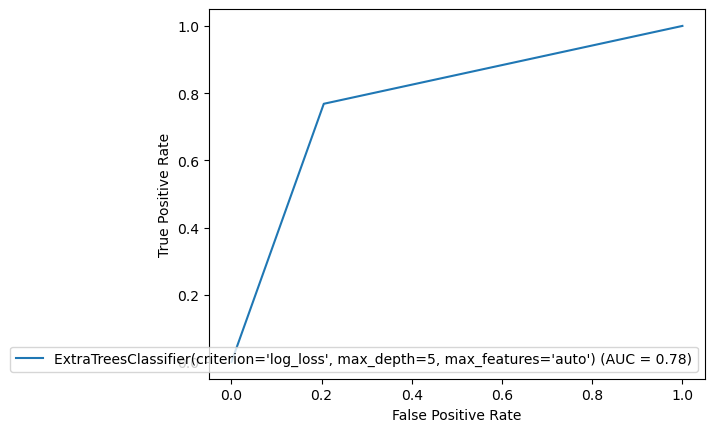

In [232]:
display_et.plot()

In [233]:
#ROC-AUC Curve for Random Forest Classifier

display_rf=metrics.RocCurveDisplay(fpr = fpr, tpr=tpr, roc_auc=roc_auc,estimator_name=Final_model_rf)

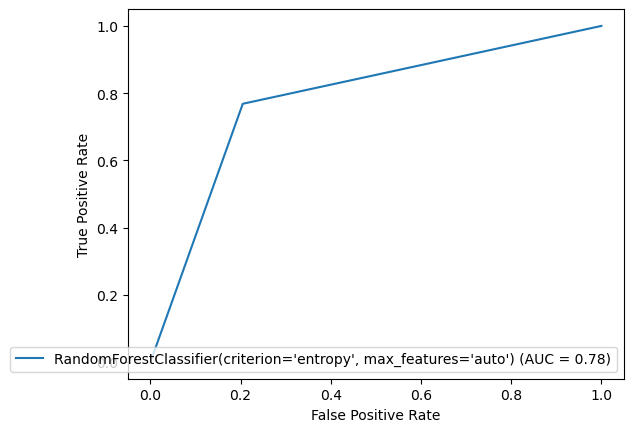

In [234]:
display_rf.plot()

In [223]:
# Cofusion matrix for Random Forest

print(confusion_matrix(y_test, rfcpred))

[[1344  151]
 [ 122 1371]]


In [224]:
# Confusion matrix for Extra Tree

print(confusion_matrix(y_test, etpred))

[[1355  140]
 [  98 1395]]


Extra Tree is the best model, it has lower accuracy but lower error which means Extra Tree is performing better.

# Saving the classification model

In [237]:
import joblib

joblib.dump(Final_model_et,'RainTomorrow-et.pkl')

['RainTomorrow-et.pkl']

# Predicting the saved model

In [239]:
# Loading the saved model
model= joblib.load('RainTomorrow-et.pkl')

#Prediction
prediction = Final_model_et.predict(x_test)
prediction

array([0, 1, 0, ..., 1, 0, 1])

In [241]:
a=np.array(y_test)

data=pd.DataFrame({'Original': a, 'Predicted': prediction})
print(data)

      Original  Predicted
0            0          0
1            0          1
2            0          0
3            0          0
4            0          0
...        ...        ...
2983         1          1
2984         0          1
2985         1          1
2986         0          0
2987         1          1

[2988 rows x 2 columns]


# Regression Task ('Rainfall ' as target)

## Separating features and label

In [242]:
x1=df.drop(['Rainfall'],axis=1)
y1=df['Rainfall']

## Feature Scaling using Standard Scalarization

In [243]:
scaler=StandardScaler()

x1=pd.DataFrame(scaler.fit_transform(x1), columns=x1.columns)
x1

,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0.069172,-0.190821,0.229802,-0.017794,1.222524,0.483303,1.317076,0.789780,0.756780,0.199610,-1.559588,-1.759834,-1.436942,1.495570,0.017600,-0.162690,-0.149628,-0.535675,-0.535916
1,-1.013829,0.174339,0.229802,-0.017794,1.413467,0.483303,-0.222676,-0.515249,0.536178,-1.395627,-1.394797,-1.252796,-1.313436,0.014663,0.017600,-0.109936,0.276421,-0.535675,-0.535916
2,-0.021078,0.273928,0.229802,-0.017794,1.604410,0.646634,1.317076,0.736496,0.977382,-1.750124,-1.120144,-1.777318,-1.154643,0.014663,-0.982885,0.558287,0.088960,-0.535675,-0.535916
3,-0.688929,0.655685,0.229802,-0.017794,-0.495963,-1.149999,0.437218,0.221878,-0.897735,-1.336544,-1.889171,-0.028909,-0.431253,0.014663,0.017600,0.048327,0.651345,-0.535675,-0.535916
4,0.809223,1.369406,0.229802,-0.017794,1.222524,0.238308,-1.322499,-0.138302,0.315576,0.849521,-0.955352,-1.217827,-1.631022,1.091303,1.603475,-0.004427,1.196689,-0.535675,-0.535916
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6404,-1.844130,-0.107830,0.229802,-0.017794,-1.259735,-0.578343,0.437218,0.369348,-0.677133,-0.982047,-1.449727,1.194978,0.892021,0.014663,0.017600,-1.358458,-0.047376,-0.535675,-0.535916
6405,-1.699730,0.207535,0.229802,-0.017794,-0.114077,-1.313329,0.437218,0.369348,-0.897735,-0.686633,-1.614519,1.002652,0.680297,0.014663,0.017600,-1.217780,0.310505,-0.535675,-0.535916
6406,-1.374830,0.473105,0.229802,-0.017794,-0.686906,-0.088352,0.437218,0.055253,-0.897735,-0.863881,-1.449727,0.565550,0.274493,0.014663,0.017600,-0.936423,0.583177,-0.535675,-0.535916
6407,-0.941629,0.489704,0.229802,-0.017794,0.458752,-0.823338,0.657182,0.369348,-1.118337,-0.982047,-1.449727,0.285805,0.221562,-0.525762,-0.982885,-0.479217,0.566135,-0.535675,-0.535916


## Checking Variance Inflation Factor VIF

In [244]:
vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x1.values, i) for i in range(len(x1.columns))]
vif['Features']=x1.columns

vif

,VIF values,Features
0,8.763567,MinTemp
1,26.181010,MaxTemp
2,1.548266,Evaporation
3,2.049245,Sunshine
4,1.353839,WindGustDir
5,2.109157,WindGustSpeed
6,1.361198,WindDir9am
7,1.739342,WindSpeed9am
8,1.935340,WindSpeed3pm
9,3.943051,Humidity9am


The feautures Temp3pm, MaxTemp, Pressure9am and Pressure3pm have slightly high VIF. We gonna try to reduce it by dropping one of the columns.

In [245]:
x1 = x1.drop('Temp3pm', axis=1)

In [246]:
# Checking again VIF

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x1.values, i) for i in range(len(x1.columns))]
vif['Features']=x1.columns

vif

,VIF values,Features
0,8.687789,MinTemp
1,9.602085,MaxTemp
2,1.547134,Evaporation
3,2.049107,Sunshine
4,1.348467,WindGustDir
5,2.101635,WindGustSpeed
6,1.359702,WindDir9am
7,1.739336,WindSpeed9am
8,1.931460,WindSpeed3pm
9,3.499969,Humidity9am


We gonna drop Pressure9am as we still have high VIF.

In [247]:
x1 = x1.drop('Pressure9am', axis=1)

In [248]:
# Checking again VIF

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x1.values, i) for i in range(len(x1.columns))]
vif['Features']=x1.columns

vif

,VIF values,Features
0,8.597166,MinTemp
1,9.237329,MaxTemp
2,1.529724,Evaporation
3,2.040548,Sunshine
4,1.294137,WindGustDir
5,2.063594,WindGustSpeed
6,1.328854,WindDir9am
7,1.723118,WindSpeed9am
8,1.919767,WindSpeed3pm
9,3.499768,Humidity9am


We gonna drop Temp9am as we still have high VIF.

In [252]:
x1 = x1.drop('Temp9am', axis=1)

In [253]:
# Checking again VIF

vif=pd.DataFrame()
vif['VIF values']=[variance_inflation_factor(x1.values, i) for i in range(len(x1.columns))]
vif['Features']=x1.columns

vif

,VIF values,Features
0,4.624750,MinTemp
1,5.501497,MaxTemp
2,1.519186,Evaporation
3,2.018207,Sunshine
4,1.293882,WindGustDir
5,2.024671,WindGustSpeed
6,1.327757,WindDir9am
7,1.715555,WindSpeed9am
8,1.876337,WindSpeed3pm
9,2.458925,Humidity9am


Now we have solved multicolinearity issue.

# Machine Learning for Regression Task (Rainfall as Target)

In [255]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import AdaBoostRegressor
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.metrics import accuracy_score, confusion_matrix,classification_report,f1_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score

## Finding the best random state

In [256]:
maxAccu=0
maxRS=0
for i in range(1,200):
    x1_train,x1_test,y1_train,y1_test=train_test_split(x1,y1,test_size=0.20,random_state=i)
    lr=LinearRegression()
    lr.fit(x1_train,y1_train)
    pred=lr.predict(x1_test)
    acc=r2_score(y1_test,pred)
    if acc>maxAccu:
        maxAccu=acc
        maxRS=i
print("Maximum R2 score is:",maxAccu,"on random state",maxRS)

Maximum R2 score is: 0.8143793898962463 on random state 155


In [257]:
x1.head()

,MinTemp,MaxTemp,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure3pm,Cloud9am,Cloud3pm,RainToday,RainTomorrow
0,0.069172,-0.190821,0.229802,-0.017794,1.222524,0.483303,1.317076,0.789780,0.756780,0.199610,-1.559588,-1.436942,1.495570,0.017600,-0.535675,-0.535916
1,-1.013829,0.174339,0.229802,-0.017794,1.413467,0.483303,-0.222676,-0.515249,0.536178,-1.395627,-1.394797,-1.313436,0.014663,0.017600,-0.535675,-0.535916
2,-0.021078,0.273928,0.229802,-0.017794,1.604410,0.646634,1.317076,0.736496,0.977382,-1.750124,-1.120144,-1.154643,0.014663,-0.982885,-0.535675,-0.535916
3,-0.688929,0.655685,0.229802,-0.017794,-0.495963,-1.149999,0.437218,0.221878,-0.897735,-1.336544,-1.889171,-0.431253,0.014663,0.017600,-0.535675,-0.535916
4,0.809223,1.369406,0.229802,-0.017794,1.222524,0.238308,-1.322499,-0.138302,0.315576,0.849521,-0.955352,-1.631022,1.091303,1.603475,-0.535675,-0.535916


In [258]:
y1.head()

0    0.843433
1    0.000000
2    0.000000
3    0.000000
4    1.000000
Name: Rainfall, dtype: float64

In [259]:
x1_train,x1_test,y1_train,y1_test=train_test_split(x1,y1,test_size=0.3, random_state=maxRS)

In [260]:
x1_train.shape

(4486, 16)

In [261]:
y1_train.shape

(4486,)

In [262]:
x1_test.shape

(1923, 16)

In [263]:
y1_test.shape

(1923,)

## Linear Regression

In [264]:
lr=LinearRegression()

In [265]:
lr.fit(x1_train,y1_train)

LinearRegression()

In [266]:
lr.score(x1_train, y1_train)

0.7844328136753377

In [267]:
lrpred=lr.predict(x1_test)

In [269]:
print('R2_score: ', r2_score(y1_test,lrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,lrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,lrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,lrpred)))

R2_score:  0.794950538581531
Mean Absolute Error:  0.25974934028135843
Mean Squared Error:  0.13377667964457224
Root Mean Squared Error:  0.3657549447985252


## Decision Tree Regressor

In [270]:
dtr = DecisionTreeRegressor()

In [271]:
dtr.fit(x1_train,y1_train)

DecisionTreeRegressor()

In [272]:
dtrpred=dtr.predict(x1_test)

In [273]:
dtr.score(x1_train, y1_train)

0.9988598609911998

In [274]:
print('R2_score: ', r2_score(y1_test,dtrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,dtrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,dtrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,dtrpred)))

R2_score:  0.5730839610757896
Mean Absolute Error:  0.30052910252618525
Mean Squared Error:  0.2785250435637074
Root Mean Squared Error:  0.5277547191297368


## Support Vector Regressor

In [275]:
svr=SVR()
svr.fit(x1_train,y1_train)
svrpred=svr.predict(x1_test)

In [276]:
svr.score(x1_train, y1_train)

0.8361908072032211

In [277]:
print('R2_score: ', r2_score(y1_test,svrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,svrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,svrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,svrpred)))

R2_score:  0.7888044783718341
Mean Absolute Error:  0.23679346554621417
Mean Squared Error:  0.13778644159206116
Root Mean Squared Error:  0.3711959611742309


## Random Forest Regressor

In [279]:
rfr=RandomForestRegressor(n_estimators=200, random_state=maxRS)
rfr.fit(x1_train, y1_train)
rfrpred= rfr.predict(x1_test)

In [280]:
rfr.score(x1_train, y1_train)

0.9697573659564408

In [281]:
print('R2_score: ', r2_score(y1_test,rfrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,rfrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,rfrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,rfrpred)))

R2_score:  0.797960881570888
Mean Absolute Error:  0.2515302127505159
Mean Squared Error:  0.13181269648206284
Root Mean Squared Error:  0.36306018300284987


## AdaBoost Regressor

In [282]:
abr=AdaBoostRegressor()
abr.fit(x1_train,y1_train)
abrpred=abr.predict(x1_test)

In [283]:
abr.score(x1_train, y1_train)

0.7126583787628953

In [284]:
print('R2_score: ', r2_score(y1_test,abrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,abrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test,abrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,abrpred)))

R2_score:  0.7121761662163482
Mean Absolute Error:  0.3887736924575035
Mean Squared Error:  0.18777965345428646
Root Mean Squared Error:  0.43333549757005424


## Ridge

In [285]:
ridge=Ridge()
ridge.fit(x1_train,y1_train)
ridgepred=ridge.predict(x1_test)

In [286]:
ridge.score(x1_train, y1_train)

0.7844327737463198

In [288]:
print('R2_score: ', r2_score(y1_test,ridgepred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test,ridgepred))
print('Mean Squared Error: ', mean_squared_error(y1_test,ridgepred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test,ridgepred)))

R2_score:  0.7949533552052932
Mean Absolute Error:  0.2597684607342388
Mean Squared Error:  0.1337748420461113
Root Mean Squared Error:  0.3657524327275367


## Lasso

In [289]:
lasso=Lasso()
lasso.fit(x1_train,y1_train)
lassopred=lasso.predict(x1_test)

In [290]:
lasso.score(x1_train, y1_train)

0.0

In [291]:
print('R2_score: ', r2_score(y1_test, lassopred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test, lassopred))
print('Mean Squared Error: ', mean_squared_error(y1_test, lassopred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test, lassopred)))

R2_score:  -1.1812777189534884e-05
Mean Absolute Error:  0.6659610754782004
Mean Squared Error:  0.6524194650073463
Root Mean Squared Error:  0.8077248696229096


## KNeighbors Regressor

In [292]:
knr = KNeighborsRegressor()
knr.fit(x1_train,y1_train)
knrpred=knr.predict(x1_test)

In [293]:
knr.score(x1_train, y1_train)

0.8298944057091915

In [294]:
print('R2_score: ', r2_score(y1_test, knrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test, knrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test, knrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test, knrpred)))

R2_score:  0.7805721409601138
Mean Absolute Error:  0.24640079867347953
Mean Squared Error:  0.143157315317041
Root Mean Squared Error:  0.37836135547521366


## GradientBoosting Regressor

In [295]:
gbr=GradientBoostingRegressor()
gbr.fit(x1_train,y1_train)
gbrpred=gbr.predict(x1_test)

In [296]:
gbr.score(x1_train, y1_train)

0.8269992673607122

In [297]:
print('R2_score: ', r2_score(y1_test, gbrpred))
print('Mean Absolute Error: ', mean_absolute_error(y1_test, gbrpred))
print('Mean Squared Error: ', mean_squared_error(y1_test, gbrpred))
print('Root Mean Squared Error: ', np.sqrt(mean_squared_error(y1_test, gbrpred)))

R2_score:  0.8049149972945935
Mean Absolute Error:  0.2452065893867562
Mean Squared Error:  0.12727574961594615
Root Mean Squared Error:  0.3567572698852066


In [304]:
model2 = {
        "Model": ['LinearRegression', 'DecisionTree Regressor', 'Support Vector Regressor', 'Random Forest Regressor', 'AdaBoost Regressor', 'Ridge','Lasso', 'KNeighbors Regressor', 'GradientBoosting Regressor', ],
        "R2 score": [0.794950538581531, 0.5730839610757896, 0.7888044783718341, 0.797960881570888, 0.7121761662163482, 0.7949533552052932, -1.1812777189534884e-05, 0.7805721409601138, 0.8049149972945935],
        "Mean Absolute Error": [0.26, 0.3, 0.24, 0.25, 0.39, 0.26, 0.67, 0.25, 0.25],
        "Mean Squared Error": [0.13, 0.28, 0.14, 0.14, 0.19, 0.13, 0.65, 0.14, 0.13],
        "Root Mean Squared Error":[0.37, 0.53, 0.37, 0.36, 0.43, 0.37, 0.81, 0.38, 0.36],
        "Accuracy score":[0.78, 0.99, 0.84, 0.97, 0.71, 0.78, 0, 0.83, 0.83]}

model2_df = pd.DataFrame(model2)

# Sort the DataFrame by "Best R2 Score" in descending order
model2_df = model2_df.sort_values(by="R2 score", ascending=False)
model2_df

,Model,R2 score,Mean Absolute Error,Mean Squared Error,Root Mean Squared Error,Accuracy score
8,GradientBoosting Regressor,0.804915,0.25,0.13,0.36,0.83
3,Random Forest Regressor,0.797961,0.25,0.14,0.36,0.97
5,Ridge,0.794953,0.26,0.13,0.37,0.78
0,LinearRegression,0.794951,0.26,0.13,0.37,0.78
2,Support Vector Regressor,0.788804,0.24,0.14,0.37,0.84
7,KNeighbors Regressor,0.780572,0.25,0.14,0.38,0.83
4,AdaBoost Regressor,0.712176,0.39,0.19,0.43,0.71
1,DecisionTree Regressor,0.573084,0.30,0.28,0.53,0.99
6,Lasso,-0.000012,0.67,0.65,0.81,0.00


Random Forest Regressor and GradientBoosting areour best models as they have high R2 score and High accuracy.

## Hyper Parameter Tuning for Rainfall target

In [308]:
# for RandomForest

param1 = {
    'n_estimators': [10, 50, 100],
    'criterion': ['squared_error', 'absolute_error', 'friedman_mse', 'poisson'],
    'max_depth': [3, 4, 5],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

In [309]:
GSCV_1=GridSearchCV(RandomForestRegressor(),param1,cv=5)

In [310]:
GSCV_1.fit(x1_train,y1_train)

GridSearchCV(cv=5, estimator=RandomForestRegressor(),
             param_grid={'criterion': ['squared_error', 'absolute_error',
                                       'friedman_mse', 'poisson'],
                         'max_depth': [3, 4, 5], 'min_samples_leaf': [1, 2, 4],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [10, 50, 100]})

In [311]:
GSCV_1.best_params_

{'criterion': 'friedman_mse',
 'max_depth': 5,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 50}

In [314]:
Final_model_regression_rf=RandomForestRegressor(n_estimators=50, criterion= 'friedman_mse', max_depth=5, min_samples_split=2, min_samples_leaf= 2)
Final_model_regression_rf.fit(x1_train, y1_train)
prediction=Final_model_regression_rf.predict(x1_test)

print("R2 score:",r2_score(y1_test,prediction))
print("Mean Absolute Error:",mean_absolute_error(y1_test,prediction))
print("Mean Squared Error:",mean_squared_error(y1_test,prediction))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y1_test,prediction)))

R2 score: 0.7984808042872359
Mean Absolute Error: 0.2526150137257287
Mean Squared Error: 0.1314734927885556
Root Mean Squared Error: 0.3625927368116405


In [315]:
# for GradientBoosting

param2={'n_estimators':[40, 60, 80, 100],
             'criterion':['squared_error', 'friedman_mse'],
             'max_depth':[2, 3, 10, 20,30],
             'min_samples_leaf':[1, 5, 10, 15, 20],
             'learning_rate':[0.0, 0.1, 0.5,1.0, 2.0]}

In [317]:
GSCV_1_gb=GridSearchCV(GradientBoostingRegressor(),param2,cv=5)

In [318]:
GSCV_1_gb.fit(x1_train,y1_train)

GridSearchCV(cv=5, estimator=GradientBoostingRegressor(),
             param_grid={'criterion': ['squared_error', 'friedman_mse'],
                         'learning_rate': [0.0, 0.1, 0.5, 1.0, 2.0],
                         'max_depth': [2, 3, 10, 20, 30],
                         'min_samples_leaf': [1, 5, 10, 15, 20],
                         'n_estimators': [40, 60, 80, 100]})

In [319]:
GSCV_1.best_params_

{'criterion': 'friedman_mse',
 'max_depth': 5,
 'min_samples_leaf': 1,
 'min_samples_split': 2,
 'n_estimators': 50}

In [320]:
Final_model_regression_gb=GradientBoostingRegressor(n_estimators=50, criterion= 'friedman_mse', max_depth=5, min_samples_split=2, min_samples_leaf= 1)
Final_model_regression_gb.fit(x1_train, y1_train)
prediction=Final_model_regression_gb.predict(x1_test)

print("R2 score:",r2_score(y1_test,prediction))
print("Mean Absolute Error:",mean_absolute_error(y1_test,prediction))
print("Mean Squared Error:",mean_squared_error(y1_test,prediction))
print("Root Mean Squared Error:",np.sqrt(mean_squared_error(y1_test,prediction)))

R2 score: 0.7995107541446312
Mean Absolute Error: 0.2487949340624081
Mean Squared Error: 0.13080154139122152
Root Mean Squared Error: 0.3616649573724575


Both model are performing good.

# Saving the regression model

In [321]:
joblib.dump(rfr, 'rainfall-rfr.pkl.obj')

['rainfall-rfr.pkl.obj']

In [322]:
joblib.dump(gbr, 'rainfall-gbr.pkl.obj')

['rainfall-gbr.pkl.obj']